BASIC EVALUATION ++++
* BERT-Unstructured-FT performance with unstructured context +
* BERT-Unstructured-FT performance with structurized context +
* BERT-Structurized-FT performance with unstructured context +
* BERT-Structurized-FT performance with structurized context +
* BERT-base performance with unstructured context +
* BERT-base performance with structurized context +

STATISTICS:
* Cosine Similarity (CS): hidden states
* Jensen-Shannon Divergence (JSD): attention distribution
* Representational Similarity Analysis (RSA): hidden states & attention distribution
* Wasserstein (Earth's Mover) Distance (EMD): hidden states & attention distribution - comparing different inputs
--------------------------------------------------------------------------------
1. prepare data for analysis (unstructured context); i.e., attention scores, hidden states (3 models) +(implicit within analyzer class)

2. prepare data for analysis (structurized context); i.e., attention scores, hidden states (3 models) +(implicit within analyzer class)
--------------------------------------------------------------------------------
BASIC VISUALS

3. Attention visualization (Grid & Interactive) +
    * base_model_unstructured_input +
    * base_model_structurized_input +
    * unstructured_model_unstructured_input +
    * unstructured_model_structurized_input +
    * structurized_model_unstructured_input +
    * structurized_model_structurized_input +

4. RDM visualization (layer similarity within model) +
    * base_model_unstructured_input +
    * base_model_structurized_input +
    * unstructured_model_unstructured_input +
    * unstructured_model_structurized_input +
    * structurized_model_unstructured_input +
    * structurized_model_structurized_input +
--------------------------------------------------------------------------------
EXPERIMENT 1: Compare models with the same input formats +

5. compare models with unstructured context input: +
    * structurized_model_unstructured_input vs base_model_unstructured_input
        * JSD & RSA on attention scores +
        * CS & RSA on hidden states
        
    * unstructured_model_unstructured_input vs base_model_unstructured_input
        * JSD & RSA on attention scores +
        * CS & RSA on hidden states
        
    * structurized_model_unstructured_input vs unstructured_model_unstructured_input
        * JSD & RSA on attention scores +
        * CS & RSA on hidden states
        
6. compare models with structurized context input: +
    * structurized_model_structurized_input vs base_model_structurized_input
        * JSD & RSA on attention scores +
        * CS & RSA on hidden states
        
    * unstructured_model_structurized_input vs base_model_structurized_input
        * JSD & RSA on attention scores +
        * CS & RSA on hidden states
        
    * structurized_model_structurized_input vs unstructured_model_structurized_input
        * JSD & RSA on attention scores +
        * CS & RSA on hidden states
        
--------------------------------------------------------------------------------
EXPERIMENT 2: Compare the same model, but with different inputs +

7. compare models with different inputs: +
    * unstructured_model_unstructured_input vs unstructured_model_structurized_input +
        * Wasserstein's (Earth's Mover) on attention scores +
        * Wasserstein's (Earth's Mover) on hidden states +
    * structurized_model_unstructured_input vs structurized_model_structurized_input +
        * Wasserstein's (Earth's Mover) on attention scores +
        * Wasserstein's (Earth's Mover) on hidden states +
    * base_model_unstructured_input vs base_model_structurized_input +
        * Wasserstein's (Earth's Mover) on attention scores +
        * Wasserstein's (Earth's Mover) on hidden states +
--------------------------------------------------------------------------------
**NOT CONDUCTED YET**

8. Further Analysis (on JSD, RSA, RDM scores):

    * Prepare for further analysis
        * Normality assumption check: Shapiro-Wilk test or Kolmogorov-Smirnov test
        * Equal variance check: Levene’s test
    * Independent Samples ANOVA (normality & equal variance)? or Kruskal-Wallis' H Test (no normality & no equal variance)?
        * unstructured_model_unstructured_input vs structurized_model_unstructured_input vs base_model_unstructured_input
        * unstructured_model_structurized_input vs structurized_model_structurized_input vs base_model_structurized_input
    * If ANOVA -> Post-Hoc Test: Tukey's HSD
    * If Kruskal-Wallis -> Post-Hoc Test: Dunn's Test with Bonferroni Correction
    * Independent Samples T-test (normality & equal variances)? Welch's T-Test (no normality & no equal variances)?
        * base_model_unstructured_input vs base_model_structurized_input
        * unstructured_model_unstructured_input vs unstructured_model_structurized_input
        * structurized_model_unstructured_input vs structurized_model_structurized_input
    * Significance reporting:
        * ANOVA -> eta-squared
        * T-test -> Cohen's D

In [1]:
!pip install --upgrade transformers datasets evaluate rsatoolbox

In [2]:
# Load models
from transformers import AutoTokenizer, AutoModelForQuestionAnswering

# Performance
from evaluate import evaluator
from datasets import load_dataset

# RSA Analysis & Visualization
import rsatoolbox
from rsatoolbox.data import Dataset
from rsatoolbox.rdm.calc import calc_rdm
from scipy.spatial.distance import pdist, squareform # new

# Jensen-Shannon Divergence
from scipy.spatial.distance import jensenshannon

# Wasserstein (Earth's Mover) Distance
from scipy.stats import wasserstein_distance

# Visualizations
import matplotlib.pyplot as plt
import seaborn as sns
import ipywidgets as widgets
from ipywidgets import interact

# Utility
import pandas as pd
import numpy as np
import torch
from typing import Optional
import torch.nn.functional as F

# Environment variables
import os
from dotenv import load_dotenv

# Functions

In [3]:
#@title QA Model Analyzer Class
class QAModelAnalyzer:
    def __init__(self, model: AutoModelForQuestionAnswering, tokenizer: AutoTokenizer, model_name: str):
        """
        Initializes the Question Answering Model Analyzer.
        :param model: Preloaded transformer model instance.
        :param tokenizer: Preloaded tokenizer instance.
        """
        self.model = model.to('cuda')
        self.tokenizer = tokenizer
        self.model_name = model_name

    def compute_metrics(self, validation_dataset, dataset_name = "squad"):
        task_evaluator = evaluator("question-answering")
        squad_v2_format = dataset_name == "squad_v2"

        metrics_result = task_evaluator.compute(
                                                model_or_pipeline=self.model,
                                                tokenizer=self.tokenizer,
                                                data=validation_dataset,
                                                metric=dataset_name,
                                                squad_v2_format=squad_v2_format,
                                            )
        return metrics_result

    def _tokenize(self, q: str, c: str):
        """Tokenizes the question and context."""
        return self.tokenizer(q, c, return_tensors="pt").to('cuda')

    def get_attention_scores(self, q: str, c: str) -> torch.Tensor:
        """Returns the attention scores tensor."""
        encoded_sample = self._tokenize(q, c)
        output = self.model(encoded_sample['input_ids'], output_attentions=True)
        return torch.stack(output['attentions'])

    def get_hidden_states(self, q: str, c: str) -> torch.Tensor:
        """Returns the hidden states tensor."""
        encoded_sample = self._tokenize(q, c)
        with torch.no_grad():
            output = self.model(**encoded_sample, output_hidden_states=True)
        return torch.stack(output.hidden_states)

    def get_decoded_tokens(self, q: str, c: str) -> list:
        """Returns the decoded tokens list."""
        encoded_sample = self._tokenize(q, c)
        input_ids = encoded_sample['input_ids'][0]
        return self.tokenizer.convert_ids_to_tokens(input_ids)

    def get_prediction(self, q: str, c: str) -> str:
        """Predicts the answer based on the question and context."""
        encoded_sample = self._tokenize(q, c)
        output = self.model(encoded_sample['input_ids'])

        start_logits = output['start_logits']
        end_logits = output['end_logits']

        start_index = torch.argmax(start_logits)
        end_index = torch.argmax(end_logits)

        decoded_tokens = self.get_decoded_tokens(q, c)
        answer_tokens = decoded_tokens[start_index: end_index + 1]

        return self.tokenizer.convert_tokens_to_string(answer_tokens)

    def visualize_attention(self, layer: int, head: int, q: str, c: str):
        """Visualizes attention weights for a given layer and head."""
        attention_tensor = self.get_attention_scores(q, c)
        decoded_tokens = self.get_decoded_tokens(q, c)
        attention_matrix = attention_tensor[layer, 0, head, :, :]

        # Normalize (optional)
        attention_matrix = attention_matrix / attention_matrix.sum(dim=-1, keepdim=True)

        # Plot heatmap
        plt.figure(figsize=(20, 20))
        sns.heatmap(attention_matrix.to('cpu').detach().numpy(), cmap="Blues", annot=False, xticklabels=decoded_tokens, yticklabels=decoded_tokens)
        plt.xlabel("Tokens Being Attended To")
        plt.ylabel("Tokens Attending")
        plt.title(f"Attention Heatmap (Layer {layer}, Head {head + 1}) of {self.model_name}")
        plt.xticks(rotation=45, ha='right', fontsize=6)
        plt.yticks(rotation=0, fontsize=6)
        plt.show()

    def interactive_attention_visualization(self, q: str, c: str):
        """Creates an interactive attention visualization widget."""
        layer_slider = widgets.IntSlider(min=0, max=11, step=1, value=11, description='Layer')
        head_slider = widgets.IntSlider(min=0, max=11, step=1, value=8, description='Head')
        interact(self.visualize_attention, layer=layer_slider, head=head_slider, q=widgets.fixed(q), c=widgets.fixed(c))

    def visualize_attention_grid(self, q: str, c: str):
        """Generates a 12x12 grid of attention heatmaps with layers as columns and heads as rows."""
        attention_tensor = self.get_attention_scores(q, c)  # Shape: (layers, batch, heads, seq_len, seq_len)
        decoded_tokens = self.get_decoded_tokens(q, c)

        fig, axs = plt.subplots(12, 12, figsize=(24, 24))
        fig.suptitle(f"Attention Head Analysis for {self.model_name}", fontsize=16) #, pad = 15

        for layer in range(12):
            for head in range(12):
                attention_matrix = attention_tensor[layer, 0, head, :, :].cpu().detach().numpy()
                attention_matrix /= attention_matrix.sum(axis=-1, keepdims=True)  # Normalize rows

                ax = axs[head, layer]
                sns.heatmap(attention_matrix, cmap="Blues", ax=ax, annot=False, xticklabels=False, yticklabels=False, cbar=False)
                if head == 0:
                    ax.set_title(f"Layer {layer}")
                if layer == 0:
                    ax.set_ylabel(f"Head {head}", rotation=90, labelpad=10)

        plt.tight_layout()
        plt.show()

    def rsa_analysis(self, representation_type: str, q: str, c: str, method: str = 'correlation', layer: Optional[int] = None):
        """Performs Representational Similarity Analysis (RSA) on attention or hidden states
        using correlation distance for a specific layer or all layers.
        Returns RDM of a specified layer or all layers."""

        data_tensor = self.get_attention_scores(q, c) if representation_type == 'attention' else self.get_hidden_states(q, c)

        if layer is not None:
            # if attention representations, average heads across a layer
            data_matrix = data_tensor[layer, 0].mean(dim=0).cpu().detach().numpy() if representation_type == 'attention' else data_tensor[layer, 0].cpu().detach().numpy()
            rsa_matrix = squareform(pdist(data_matrix, metric=method)) # rdm matrix computation
            return rsa_matrix # return RDM of a specific layer

        rdms = {}
        for i in range(data_tensor.shape[0]):
            # if attention representations, average heads across layers
            data_matrix = data_tensor[i, 0].mean(dim=0).cpu().detach().numpy() if representation_type == 'attention' else data_tensor[i, 0].cpu().detach().numpy()
            rdms[i] = squareform(pdist(data_matrix, metric=method)) # rdm matrices computation
        return rdms # return RDMs of all layers

    def rsa_analysis_visualization(self, representation_type: str, q: str, c: str, method: str = 'correlation'):
        """Performs RSA for all layers and visualizes RDMs in a grid format with 5 columns and a shared color bar."""
        rdms = self.rsa_analysis(representation_type, q, c, method)
        num_layers = len(rdms)
        num_cols = 5
        num_rows = (num_layers + num_cols - 1) // num_cols  # Ensure all layers fit
        fig, axs = plt.subplots(num_rows, num_cols, figsize=(num_cols * 4, num_rows * 4)) # , constrained_layout=True

        vmin = np.min([np.min(rdm) for rdm in rdms.values()])
        vmax = np.max([np.max(rdm) for rdm in rdms.values()])

        fig.suptitle(f"RDMs across layers for {self.model_name}")
        # and we add one plot per reference point
        fig.subplots_adjust(wspace=0.3, hspace=0.4)

        for layer, ax in zip(rdms.keys(), axs.flatten()):
            sns.heatmap(rdms[layer], cmap='magma_r', ax=ax, annot=False, vmin=vmin, vmax=vmax, cbar=False)
            ax.set_title(f"Layer {layer}")

        for i in range(num_layers, num_rows * num_cols):
            fig.delaxes(axs.flatten()[i])  # Remove unused subplots

        cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])  # Shared color bar
        sm = plt.cm.ScalarMappable(cmap='magma_r', norm=plt.Normalize(vmin=vmin, vmax=vmax))
        fig.colorbar(sm, cax=cbar_ax)

        plt.show()

In [4]:
class QAModelComparator:
    def __init__(self, analysed_model1: QAModelAnalyzer, analysed_model2: QAModelAnalyzer):
        """
        Initializes the QA Model Comparator.
        :param analysed_model1: Instance of QAModelAnalyzer for the first model.
        :param analysed_model2: Instance of QAModelAnalyzer for the second model.
        """
        self.model_1 = analysed_model1
        self.model_2 = analysed_model2

    def compare_layerwise_jsd(self, question: str, context: str, representation_type: str = "hidden_states"):
        if representation_type == "attention":
            data_1 = self.model_1.get_attention_scores(question, context)
            data_2 = self.model_2.get_attention_scores(question, context)
        else:
            data_1 = self.model_1.get_hidden_states(question, context)
            data_2 = self.model_2.get_hidden_states(question, context)

        jsd_scores = {}

        for layer in range(data_1.shape[0]):
            if representation_type == "attention":
                # Assume attention scores are already normalized.
                rep1 = data_1[layer, 0].mean(dim=0).cpu().detach()
                rep2 = data_2[layer, 0].mean(dim=0).cpu().detach()
                # Directly flatten them as probability distributions.
                p_dist = rep1.flatten().to(torch.float64).cpu().numpy()
                q_dist = rep2.flatten().to(torch.float64).cpu().numpy()
            else:
                # For hidden states, apply softmax to get a valid probability distribution.
                rep1 = data_1[layer, 0].cpu().detach()
                rep2 = data_2[layer, 0].cpu().detach()
                rep1_flat = rep1.flatten().to(torch.float64)
                rep2_flat = rep2.flatten().to(torch.float64)
                p_dist = F.softmax(rep1_flat, dim=0).cpu().numpy()
                q_dist = F.softmax(rep2_flat, dim=0).cpu().numpy()

            jsd = jensenshannon(p_dist, q_dist)
            jsd_scores[layer] = jsd

        return jsd_scores

    def compare_rsa(self, question: str, context: str, method: str = 'correlation', representation_type: str = "hidden_states"):
        """
        Computes Representational Similarity Analysis (RSA) for each layer between two models.
        Here we compute the representational dissimilarity matrices (RDMs) for each layer
        (using the specified distance metric) and then return the absolute difference between them.
        :param question: Question input.
        :param context: Context input.
        :param method: Distance metric ('correlation' or 'cosine').
        :param representation_type: 'hidden_states' or 'attention'.
        :return: Dictionary of RSA difference matrices per layer.
        """
        if representation_type == "attention":
            data_1 = self.model_1.get_attention_scores(question, context)
            data_2 = self.model_2.get_attention_scores(question, context)
        else:
            data_1 = self.model_1.get_hidden_states(question, context)
            data_2 = self.model_2.get_hidden_states(question, context)

        rsa_matrices = {}

        for layer in range(data_1.shape[0]):
            if representation_type == "attention":
                rep1 = data_1[layer, 0].mean(dim=0).cpu().detach().numpy()  # shape: (seq_len, seq_len)
                rep2 = data_2[layer, 0].mean(dim=0).cpu().detach().numpy()
            else:
                rep1 = data_1[layer, 0].cpu().detach().numpy()  # shape: (seq_len, hidden_dim)
                rep2 = data_2[layer, 0].cpu().detach().numpy()

            # Compute the representational dissimilarity matrices (RDMs) using pdist.
            rdm1 = squareform(pdist(rep1, metric=method))
            rdm2 = squareform(pdist(rep2, metric=method))
            # Compute elementwise absolute difference between the two RDMs.
            diff_rdm = np.abs(rdm1 - rdm2)
            rsa_matrices[layer] = diff_rdm

        return rsa_matrices

    def compare_cosine_similarity(self, question: str, context: str, representation_type: str = "hidden_states"):
        """
        Computes the cosine similarity between the hidden states or attention scores of two models.
        :param question: Question input.
        :param context: Context input.
        :param representation_type: 'hidden_states' or 'attention'.
        :return: Dictionary of cosine similarity scores per layer.
        """
        if representation_type == "attention":
            data_1 = self.model_1.get_attention_scores(question, context)
            data_2 = self.model_2.get_attention_scores(question, context)
        else:
            data_1 = self.model_1.get_hidden_states(question, context)
            data_2 = self.model_2.get_hidden_states(question, context)

        cosine_similarities = {}

        for layer in range(data_1.shape[0]):
            if representation_type == "attention":
                rep1 = data_1[layer, 0].mean(dim=0)  # shape: (seq_len, seq_len)
                rep2 = data_2[layer, 0].mean(dim=0)
            else:
                rep1 = data_1[layer, 0]  # shape: (seq_len, hidden_dim)
                rep2 = data_2[layer, 0]

            # Flatten the representations
            rep1_flat = rep1.flatten()
            rep2_flat = rep2.flatten()

            # Compute cosine similarity
            similarity = F.cosine_similarity(rep1_flat, rep2_flat, dim=0).item()
            cosine_similarities[layer] = similarity

        return cosine_similarities

    def plot_jsd(self, question: str, context: str, representation_type: str = "hidden_states"):
        """
        Visualizes the layerwise Jensen-Shannon Divergence as a bar plot.
        """
        jsd_scores = self.compare_layerwise_jsd(question, context, representation_type)
        layers = list(jsd_scores.keys())
        values = [jsd_scores[layer] for layer in layers]

        plt.figure(figsize=(10, 5))
        plt.bar(layers, values, color='skyblue')
        plt.xlabel("Layer")
        plt.ylabel("Jensen-Shannon Divergence")
        plt.title(f"JSD Between {self.model_1.model_name} and {self.model_2.model_name} ({representation_type})")
        plt.xticks(layers)
        plt.grid(axis='y')
        plt.show()

    def plot_rsa(self, question: str, context: str, method: str = 'correlation', representation_type: str = "hidden_states"):
        """
        Plots RSA difference matrices as heatmaps across layers.
        """
        rsa_matrices = self.compare_rsa(question, context, method, representation_type)

        if not rsa_matrices:
            print("No valid RSA matrices to plot.")
            return

        num_layers = len(rsa_matrices)
        num_cols = 5
        num_rows = (num_layers + num_cols - 1) // num_cols

        fig, axs = plt.subplots(num_rows, num_cols, figsize=(num_cols * 4, num_rows * 4))
        fig.suptitle(f"RSA Differences Between {self.model_1.model_name} and {self.model_2.model_name} ({representation_type})", fontsize=14)

        # Dynamically define color scale limits from the nonzero elements of all RSA matrices.
        vmin_candidates = [np.min(matrix[matrix > 0]) for matrix in rsa_matrices.values() if np.any(matrix > 0)]
        vmin = np.min(vmin_candidates) if vmin_candidates else 0
        vmax = np.max([np.max(matrix) for matrix in rsa_matrices.values()])

        for layer, ax in zip(rsa_matrices.keys(), axs.flatten()):
            sns.heatmap(rsa_matrices[layer], cmap='magma_r', ax=ax, annot=False, vmin=vmin, vmax=vmax, cbar=False)
            ax.set_title(f"Layer {layer}", fontsize=10, pad=10)
            ax.tick_params(axis='both', which='both', length=0)
            # If the matrix is large, reduce tick frequency.
            if rsa_matrices[layer].shape[0] > 50:
                step = max(1, rsa_matrices[layer].shape[0] // 10)
                ax.set_xticks(np.arange(0, rsa_matrices[layer].shape[0], step))
                ax.set_yticks(np.arange(0, rsa_matrices[layer].shape[0], step))
                ax.set_xticklabels(np.arange(0, rsa_matrices[layer].shape[0], step), fontsize=6, rotation=90)
                ax.set_yticklabels(np.arange(0, rsa_matrices[layer].shape[0], step), fontsize=6)

        # Remove any extra subplots.
        for i in range(num_layers, num_rows * num_cols):
            fig.delaxes(axs.flatten()[i])

        # Add a color bar on the right.
        cbar_ax = fig.add_axes([0.92, 0.2, 0.015, 0.6])
        sm = plt.cm.ScalarMappable(cmap='magma_r', norm=plt.Normalize(vmin=vmin, vmax=vmax))
        fig.colorbar(sm, cax=cbar_ax)

        plt.tight_layout(rect=[0, 0, 0.9, 1])
        plt.show()

    def plot_cosine_similarity(self, question: str, context: str, representation_type: str = "hidden_states"):
        """
        Plots cosine similarity scores as a bar plot.
        """
        cosine_similarities = self.compare_cosine_similarity(question, context, representation_type)
        layers = list(cosine_similarities.keys())
        values = [cosine_similarities[layer] for layer in layers]
        plt.figure(figsize=(10, 5))
        plt.bar(layers, values, color='salmon')
        plt.xlabel("Layer")
        plt.ylabel("Cosine Similarity")
        plt.title(f"Cosine Similarity Between {self.model_1.model_name} and {self.model_2.model_name} ({representation_type})")
        plt.xticks(layers)
        plt.grid(axis='y')
        plt.show()

In [5]:
class MultiModelComparator:
    def __init__(self, comparators: list):
        """
        Initializes the Multi-Model Comparator.
        :param comparators: A list of QAModelComparator instances.
                            Each instance compares two different models.
        """
        self.comparators = comparators

    def multi_plot_jsd(self, question: str, context: str, representation_type: str = "hidden_states", chart_type: str = "line"):
        """
        Computes and plots layerwise JSD curves from multiple QAModelComparator objects on one chart.

        :param question: The question input.
        :param context: The context input (same input is used for all comparisons).
        :param representation_type: "hidden_states" or "attention".
        :param chart_type: "line" or "bar". (Line chart is recommended for multiple curves.)
        """
        plt.figure(figsize=(10, 6))
        for comp in self.comparators:
            # Each comparator computes JSD between its two models for the same question and context.
            jsd_scores = comp.compare_layerwise_jsd(question, context, representation_type)
            layers = sorted(jsd_scores.keys())
            values = [jsd_scores[layer] for layer in layers]
            # Create a label using the compared models' names.
            label = f"{comp.model_1.model_name} vs {comp.model_2.model_name}"
            if chart_type == "line":
                plt.plot(layers, values, marker='o', linestyle='-', label=label)
            elif chart_type == "bar":
                plt.bar(layers, values, label=label, alpha=0.7)
        plt.xlabel("Layer")
        plt.ylabel("Jensen–Shannon Divergence")
        plt.title(f"Combined JSD Across Layers ({representation_type})")
        plt.xticks(layers)
        plt.grid(True)
        plt.legend()
        plt.show()

    def multi_plot_cosine_similarity(self, question: str, context: str, representation_type: str = "hidden_states", chart_type: str = "line"):
        """
        Plots cosine similarity scores from multiple QAModelComparator objects on one chart.
        """
        plt.figure(figsize=(10, 6))
        for comp in self.comparators:
            cosine_similarities = comp.compare_cosine_similarity(question, context, representation_type)
            layers = sorted(cosine_similarities.keys())
            values = [cosine_similarities[layer] for layer in layers]
            label = f"{comp.model_1.model_name} vs {comp.model_2.model_name}"
            if chart_type == "line":
                plt.plot(layers, values, marker='o', linestyle='-', label=label)
            elif chart_type == "bar":
                plt.bar(layers, values, label=label, alpha=0.7)
            plt.xlabel("Layer")
        plt.ylabel("Cosine Similarity")
        plt.title("Combined Cosine Similarity Across Layers")
        plt.xticks(layers)
        plt.grid(True)
        plt.legend()
        plt.show()


In [6]:
# class QAInputComparator:
#     def __init__(self, q: str, c1: str, c2: str):
#         """
#         Initializes the QA Input Comparator.
#         :param q: Question input.
#         :param c1: Context input 1; unstructured context.
#         :param c2: Context input 2; structured context.
#         """
#         self.question = q
#         self.context1 = c1
#         self.context2 = c2

#     def compare_contexts_rsa(self, analysed_model, representation_type: str = "hidden_states", method: str = 'correlation'):
#         """
#         Compares the two context inputs using a distance measure computed on pooled representations.
#         For hidden states: performs mean pooling over tokens (dimension 0) to get a fixed-size vector.
#         For attention: performs global pooling (mean over all tokens) to yield a scalar.
#         Returns a dictionary mapping each layer to a distance (e.g. Euclidean distance).
#         """
#         if representation_type == "attention":
#             data1 = analysed_model.get_attention_scores(self.question, self.context1)
#             data2 = analysed_model.get_attention_scores(self.question, self.context2)
#         else:
#             data1 = analysed_model.get_hidden_states(self.question, self.context1)
#             data2 = analysed_model.get_hidden_states(self.question, self.context2)

#         rsa_distances = {}

#         for layer in range(data1.shape[0]):
#             if representation_type == "attention":
#                 # Average over heads (if not already done) then pool over tokens.
#                 rep1 = data1[layer, 0].mean(dim=0).cpu().detach()  # shape: (seq_len, seq_len)
#                 rep2 = data2[layer, 0].mean(dim=0).cpu().detach()
#                 # Global mean pooling over all token positions → scalar
#                 pooled1 = rep1.mean()
#                 pooled2 = rep2.mean()
#                 # Use absolute difference between scalars as a (global) distance.
#                 distance = abs(pooled1.item() - pooled2.item())
#             else:
#                 # For hidden states, assume shape is (num_tokens, hidden_dim)
#                 rep1 = data1[layer, 0].cpu().detach()  # shape: (T1, hidden_dim)
#                 rep2 = data2[layer, 0].cpu().detach()  # shape: (T2, hidden_dim)
#                 # Mean-pool over the token (sequence) dimension to get a fixed-size vector.
#                 pooled1 = rep1.mean(dim=0)  # shape: (hidden_dim,)
#                 pooled2 = rep2.mean(dim=0)  # shape: (hidden_dim,)
#                 # Compute Euclidean distance between these fixed-size vectors.
#                 distance = torch.norm(pooled1 - pooled2).item()
#             rsa_distances[layer] = distance

#         return rsa_distances

#     def compare_contexts_jsd(self, analysed_model, representation_type: str = "hidden_states"):
#         """
#         Computes the Jensen–Shannon divergence (JSD) between the pooled representations of the two contexts.
#         For hidden states: applies mean pooling over tokens to obtain a fixed-size vector, then uses softmax to obtain a probability distribution.
#         For attention: assumes the attention scores are already normalized and applies global mean pooling (yielding a scalar) and then uses absolute difference.
#         Returns a dictionary mapping each layer to a JSD (or a surrogate divergence in the attention case).
#         """
#         if representation_type == "attention":
#             data1 = analysed_model.get_attention_scores(self.question, self.context1)
#             data2 = analysed_model.get_attention_scores(self.question, self.context2)
#         else:
#             data1 = analysed_model.get_hidden_states(self.question, self.context1)
#             data2 = analysed_model.get_hidden_states(self.question, self.context2)

#         jsd_scores = {}

#         for layer in range(data1.shape[0]):
#             if representation_type == "attention":
#                 rep1 = data1[layer, 0].mean(dim=0).cpu().detach()  # shape: (seq_len, seq_len)
#                 rep2 = data2[layer, 0].mean(dim=0).cpu().detach()
#                 # Global pooling over tokens → scalar
#                 pooled1 = rep1.mean()
#                 pooled2 = rep2.mean()
#                 # With scalars, we simply use the absolute difference as a surrogate divergence.
#                 divergence = abs(pooled1.item() - pooled2.item())
#             else:
#                 rep1 = data1[layer, 0].cpu().detach()  # shape: (T1, hidden_dim)
#                 rep2 = data2[layer, 0].cpu().detach()  # shape: (T2, hidden_dim)
#                 # Mean-pool over tokens to get fixed-size vectors.
#                 pooled1 = rep1.mean(dim=0)  # shape: (hidden_dim,)
#                 pooled2 = rep2.mean(dim=0)  # shape: (hidden_dim,)
#                 # Flatten (already 1D) and apply softmax to obtain a probability distribution.
#                 rep1_flat = pooled1.flatten().to(torch.float64)
#                 rep2_flat = pooled2.flatten().to(torch.float64)
#                 p_dist = F.softmax(rep1_flat, dim=0).cpu().numpy()
#                 q_dist = F.softmax(rep2_flat, dim=0).cpu().numpy()
#                 divergence = jensenshannon(p_dist, q_dist)
#             jsd_scores[layer] = divergence

#         return jsd_scores

#     def plot_contexts_rsa(self, analysed_model, representation_type: str = "hidden_states", method: str = 'correlation'):
#         """
#         Plots a bar chart of the RSA distances (computed on the pooled representations) across layers.
#         """
#         rsa_distances = self.compare_contexts_rsa(analysed_model, representation_type, method)
#         layers = list(rsa_distances.keys())
#         values = [rsa_distances[layer] for layer in layers]
#         plt.figure(figsize=(10, 5))
#         plt.bar(layers, values, color='salmon')
#         plt.xlabel("Layer")
#         plt.ylabel("Distance (pooled RSA)")
#         plt.title(f"RSA Distance Between Contexts for {analysed_model.model_name} ({representation_type})")
#         plt.xticks(layers)
#         plt.grid(axis='y')
#         plt.show()

#     def plot_contexts_jsd(self, analysed_model, representation_type: str = "hidden_states"):
#         """
#         Plots a bar chart of the Jensen–Shannon divergence (or surrogate for attention) across layers.
#         """
#         jsd_scores = self.compare_contexts_jsd(analysed_model, representation_type)
#         layers = list(jsd_scores.keys())
#         values = [jsd_scores[layer] for layer in layers]
#         plt.figure(figsize=(10, 5))
#         plt.bar(layers, values, color='skyblue')
#         plt.xlabel("Layer")
#         plt.ylabel("Jensen–Shannon Divergence (pooled)")
#         plt.title(f"JSD Between Contexts for {analysed_model.model_name} ({representation_type})")
#         plt.xticks(layers)
#         plt.grid(axis='y')
#         plt.show()

class QAInputComparator:
    def __init__(self, question: str, context: str, structured_context: str):
        """
        Initializes the QA Input Comparator to compare the effect of different inputs on a model.
        :param question: The question input.
        :param context: The unstructured context input.
        :param structured_context: The structured context input.
        """
        self.question = question
        self.context = context
        self.structured_context = structured_context

    def compute_wasserstein(self, X: np.ndarray, Y: np.ndarray, global_flatten: bool = False) -> float:
        """
        Computes an approximate Wasserstein distance between two sets of samples.
        If global_flatten is False, it assumes X and Y have shape (n, d) with the same d and computes the
        Wasserstein distance for each dimension (1D) and then averages.
        If global_flatten is True, it flattens the arrays into 1D vectors and computes the Wasserstein distance directly.

        :param X: numpy array (n, d) or any shape.
        :param Y: numpy array (m, d) or any shape.
        :param global_flatten: If True, flatten X and Y into 1D arrays before computing the distance.
        :return: The computed Wasserstein distance.
        """
        if global_flatten:
            return wasserstein_distance(X.flatten(), Y.flatten())
        else:
            # Assumes X and Y have the same second dimension (feature dimension)
            d = X.shape[1]
            distances = []
            for i in range(d):
                wd = wasserstein_distance(X[:, i], Y[:, i])
                distances.append(wd)
            return np.mean(distances)

    def compare_layerwise_wasserstein(self, model, representation_type: str = "hidden_states") -> dict:
        """
        Computes the Wasserstein distance between the representations for two different inputs
        (context vs. structured_context) for a given model, layer by layer.

        For hidden states, token-level representations (shape (T, D)) are used and the distance is computed
        dimension-wise (averaged over D). For attention outputs (shape (T, T)), we compute the distance globally.

        :param model: An instance of QAModelAnalyzer.
        :param representation_type: "hidden_states" or "attention". For "attention", scores are assumed normalized.
        :return: Dictionary mapping layer index to the computed Wasserstein distance.
        """
        # For input 1, use (question, context); for input 2, use (question, structured_context)
        if representation_type == "attention":
            data1 = model.get_attention_scores(self.question, self.context)
            data2 = model.get_attention_scores(self.question, self.structured_context)
        else:
            data1 = model.get_hidden_states(self.question, self.context)
            data2 = model.get_hidden_states(self.question, self.structured_context)

        wasserstein_scores = {}
        # Compare only the layers that both inputs provide.
        min_layers = min(data1.shape[0], data2.shape[0])
        for layer in range(min_layers):
            # Extract the token-level representations for this layer.
            matrix1 = data1[layer, 0].cpu().detach().numpy()
            matrix2 = data2[layer, 0].cpu().detach().numpy()

            if representation_type == "attention":
                # For attention, the matrices are square (T x T) but T may differ.
                # Flatten the matrices and compute the 1D Wasserstein distance.
                wd = self.compute_wasserstein(matrix1, matrix2, global_flatten=True)
            else:
                # For hidden states, assume matrix shape is (T, D) with the same D across inputs.
                wd = self.compute_wasserstein(matrix1, matrix2, global_flatten=False)
            wasserstein_scores[layer] = wd
        return wasserstein_scores

    def plot_wasserstein(self, model, representation_type: str = "hidden_states"):
        """
        Plots a line chart of the layer-wise Wasserstein distance values between the two inputs.

        :param model: An instance of QAModelAnalyzer.
        :param representation_type: "hidden_states" or "attention".
        """
        ws_scores = self.compare_layerwise_wasserstein(model, representation_type)
        layers = sorted(ws_scores.keys())
        values = [ws_scores[layer] for layer in layers]
        plt.figure(figsize=(10, 5))
        plt.plot(layers, values, marker='o', linestyle='-', color='green', label="Wasserstein")
        plt.xlabel("Layer")
        plt.ylabel("Wasserstein Distance")
        plt.title(f"Wasserstein Distance Across Layers for {model.model_name} ({representation_type})")
        plt.xticks(layers)
        plt.grid(True)
        plt.legend()
        plt.show()

In [7]:
class MultiModelInputComparator(QAInputComparator):
    def multi_plot(self, models: list, representation_type: str = "hidden_states"):
        """
        Computes and plots layerwise Wasserstein distances for multiple models on one combined chart.

        :param models: A list of QAModelAnalyzer instances.
        :param representation_type: "hidden_states" or "attention".
        """
        plt.figure(figsize=(10, 6))
        for model in models:
            ws_scores = self.compare_layerwise_wasserstein(model, representation_type)
            layers = sorted(ws_scores.keys())
            values = [ws_scores[layer] for layer in layers]
            plt.plot(layers, values, marker='o', linestyle='-', label=model.model_name)

        plt.xlabel("Layer")
        plt.ylabel("Wasserstein Distance")
        plt.title(f"Combined Wasserstein Distance Across Layers ({representation_type})")
        plt.xticks(layers)
        plt.grid(True)
        plt.legend()
        plt.show()

## Examples

In [8]:
example1_context = """Comprehensive prevention measures for malignant diseases in the rice seedling stage are as follows:
1. Choose disease-free seeds. Do not leave seeds in diseased fields and nearby rice fields. Choose healthy rice and
eliminate diseased, dead, and injured rice.
2. Seed disinfection. Before sowing, soak the seeds with 25% 100g (Xibok) EC 3000 times liquid for 1 to 2 days, or
take 20 grams of 17% Dexinqing wettable powder for every 6 kilograms of rice seeds. Soak the seeds in 8 kg of water
for 60 hours.
3. Deal with diseased rice straw. Do not cover germinated or dry seedlings with diseased straw."""

example1_structurized = """## Statement's scope:
```The comprehensive prevention measures for malignant diseases in rice seedling```
## Statement's main aspects and corresponding descriptions:
```
1. Choose disease-free seeds
1.1 Do not leave seeds in diseased fields and nearby rice fields.
1.2 Choose healthy rice and eliminate diseased, dead, and injured rice.
2. Seed disinfection
2.1 Before sowing, soak the seeds with 25% 100g (Xibok) EC 3000 times liquid for 1 to 2 days.
2.2 An alternative is taking 20 grams of 17% Dexinqing wettable powder for every 6 kilograms of rice seeds.
2.3 Soak the seeds in 8 kg of water for 60 hours.
3. Deal with diseased rice straw
3.1 Do not cover germinated or dry seedlings with diseased straw.
```"""

example1_question = """According to the measures, where should seeds not be left??"""
example1_answer = ["diseased fields and nearby rice fields", "in diseased fields and nearby rice fields", "Do not leave seeds in diseased fields and nearby rice fields"]

In [9]:
example2_context = """The water absorption curve of rice after soaking is an unimodal curve. The inflection point of the curve is the peak
period of water absorption. The relationship between rice water absorption and time is non-linear and can be
expressed by the following formula: a*t+b=c, where a, b, and c are constants. Under different humidity conditions,
the change in the water absorption rate of rice with time is basically similar, that is, the water absorption rate is
between 0 and the point d inflection, and the rate of change accelerates over time. After the inflection point, the
increase in water absorption gradually stabilizes. The changing rules of water absorption and moisture content of
rice are similar, but under different humidity conditions, the relationship between water absorption of rice and
moisture content is different. When the moisture content is low, the water absorption of rice increases as the
moisture content increases. When the moisture content is high, the increase in water absorption of rice gradually
stabilizes. There are three obvious steps for rice seeds to absorb water: First, at the beginning of water absorption,
the water content of the seeds gradually increases, and the water absorption rate slowly increases. Second, during
the peak water absorption period, the water absorption rate increases rapidly. Third, in the later stage of water
absorption, the water content of seeds slowly increases, and the water absorption rate increases. The water
absorption rate of rice seeds is closely related to temperature. In general, water absorption increases as
temperature increases. The relationship between water absorption and temperature can be expressed as: unsaturated
water absorption (%) = 14.289T-10.719 (where T is temperature)"""

example2_structurized = """## Statement's scope:
```characteristics of soaking rice seeds to absorb sufficient water```
## Statement's main aspects and corresponding descriptions:
```
1. The water absorption curve
1.1 The water absorption curve of rice after soaking is an unimodal curve.
1.2 The inflection point is the peak period of water absorption.
1.3 The relationship between rice water absorption and time is non-linear, which can be expressed by a*t+b=c,
where a, b, and c are constants.
2. Rice water absorption as time changes
2.1 Under different humidity conditions, the change in the water absorption rate of rice with time is basically
similar.
2.2 The water absorption rate is between 0 and the point d inflection.
3.3 The rate of change accelerates over time
2.3 After the inflection point, the increase in water absorption gradually stabilizes.
3. Relationship between rice water absorption and moisture content
3.1 The changing rules of water absorption and moisture content of rice are similar
3.2 Under different humidity conditions, the relationship between water absorption of rice and moisture content
is different.
3.3 When the moisture content is low, the water absorption of rice increases as the moisture content increases.
3.4 When the moisture content is high, the increase in water absorption of rice gradually stabilizes.
4. Three stages for rice seeds to absorb water
4.1 At the beginning of water absorption, the water content of the seeds gradually increases, and the water
absorption rate slowly increases.
4.2 During the peak water absorption period, the water absorption rate increases rapidly.
4.3 In the later stage of water absorption, the water content of seeds slowly increases, and the water absorption
rate increases.
5. Relationship between water absorption rate and temperature
5.1 The water absorption rate of rice seeds is closely related to temperature.
5.2 Water absorption generally increases as temperature increases.
5.3 The relationship can be expressed as: unsaturated water absorption (%) = 14.289T-10.719 (where T is
temperature)
```"""
example2_question = "What type of curve is described for rice water absorption after soaking?"
example2_answer = ["an unimodal curve", "unimodal curve"]

In [10]:
#@title Out-of-Distribution input - Written by Gemini
context = """The Amazon rainforest, often referred to as the 'lungs of the Earth',
plays a crucial role in regulating the global climate. Its vast expanse of trees
absorbs carbon dioxide from the atmosphere, helping to mitigate the effects of
greenhouse gas emissions.  However, the Amazon is under threat from deforestation,
driven by activities such as logging, agriculture, and mining."""

structurized_context = """1. The Amazon's role in climate regulation
1.1 The Amazon rainforest is vital in regulating the global climate, earning it the nickname 'lungs of the Earth'.
1.2 Its vast tree cover absorbs carbon dioxide, mitigating greenhouse gas emissions' impact.

2. Threats to the Amazon
2.1 Deforestation poses a significant threat to the Amazon.
2.2 Activities like logging, agriculture, and mining drive deforestation."""

question = "What poses a significant threat to the Amazon?"
ood_answer = "deforestation"

## RDM Functions - rsatoolbox (OLD)

These RSA functions are using rsatoolbox library. The library has its own Dataset class implementation that holds features and layers.

For direct calculations and RSA visualizations, QAModelAnalyzer class implementation is utilized.

In [11]:
#@title Calculate RDMs of All Layers
def calc_rdms(model_features: dict, method: str='correlation') -> dict:
    """
    Calculates representational dissimilarity matrices (RDMs) for model features.

    Inputs:
    - model_features (dict): A dictionary where keys are layer names and values are features of the layers.
    - method (str): The method to calculate RDMs, e.g., 'correlation'. Default is 'correlation'.

    Outputs:
    - rdms (pyrsa.rdm.RDMs): RDMs object containing dissimilarity matrices.
    - rdms_dict (dict): A dictionary with layer names as keys and their corresponding RDMs as values.
    """
    ds_list = []
    for l in range(len(model_features)):
        layer = list(model_features.keys())[l]
        feats = model_features[layer]

        if type(feats) is list:
            feats = feats[-1]

        feats = feats.cpu()

        if len(feats.shape) > 2:
            feats = feats.flatten(1)

        feats = feats.detach().numpy()
        ds = Dataset(feats, descriptors=dict(layer=layer))
        ds_list.append(ds)

    rdms = calc_rdm(ds_list, method=method)
    rdms_dict = {list(model_features.keys())[i]: rdms.get_matrices()[i] for i in range(len(model_features))}

    return rdms, rdms_dict

In [12]:
#@title RDMs Visualization
def plot_maps(model_features, model_name):
    """
    Plots representational dissimilarity matrices (RDMs) across different layers of a model.

    Inputs:
    - model_features (dict): a dictionary where keys are layer names and values are numpy arrays representing RDMs for each layer.
    - model_name (str): the name of the model being visualized.
    """
    # Create a figure with subplots
    nrows = 3
    ncols = 4 if len(model_features) <= 12 else 5
    fig, axs = plt.subplots(nrows, ncols, figsize=(ncols*4, nrows*4))
    # fig = plt.figure(figsize=(16, 12))

    fig.suptitle(f"RDMs across layers for {model_name}")
    # and we add one plot per reference point
    gs = fig.add_gridspec(1, len(model_features))
    fig.subplots_adjust(wspace=0.3, hspace=0.4)

    for l in range(len(model_features)):

        layer = list(model_features.keys())[l] # layer names list
        map_ = np.squeeze(model_features[layer]) # RDM for a layer

        if len(map_.shape) < 2:
            map_ = map_.reshape( (int(np.sqrt(map_.shape[0])), int(np.sqrt(map_.shape[0]))) )

        map_ = map_ / np.max(map_) # normalization ?

        column_index = l%ncols
        row_index = l//ncols
        ax = axs[row_index, column_index]
        ax_ = ax.imshow(map_, cmap='magma_r')
        ax.set_title(f'{layer}')
        ax.set_xlabel("input index")
        if l==0:
            ax.set_ylabel("input index")

    fig.subplots_adjust(right=0.9)
    cbar_ax = fig.add_axes([1.01, 0.18, 0.01, 0.53])
    cbar = fig.colorbar(ax_, cax=cbar_ax)
    cbar.set_label('Dissimilarity', rotation=270, labelpad=15)

    plt.show()

## Comparing Scores (OLD)

These Jensen-Shannon Divergence functions are old implementation. QAModelComparator class is implemented and will be used instead.

In [13]:
#@title Compare Attention Scores using Jensen-Shannon Divergence
def compare_attention_scores(model_structurized_scores, model_unstructured_scores):
    """
    Compares attention scores between two models layer-wise and head-wise using Jensen-Shannon divergence.

    Args:
        model_structurized_scores: Attention scores from the structurized model (torch.Tensor).
        model_unstructured_scores: Attention scores from the unstructured model (torch.Tensor).

    Returns:
        A dictionary where keys are layer and head indices, and values are the JSD between the corresponding attention scores.
    """

    jsd_scores = {}
    num_layers = model_structurized_scores.shape[0]  # Assuming both models have the same number of layers
    num_heads = model_structurized_scores.shape[2]   # Assuming both models have the same number of heads

    for layer in range(num_layers):
        for head in range(num_heads):

            # Extract attention scores for the specific layer and head
            structurized_attention = model_structurized_scores[layer, 0, head, :, :].detach().cpu().numpy()
            unstructured_attention = model_unstructured_scores[layer, 0, head, :, :].detach().cpu().numpy()

            # Normalize attention scores (important for JSD)
            structurized_attention = structurized_attention / np.sum(structurized_attention)
            unstructured_attention = unstructured_attention / np.sum(unstructured_attention)

            # Calculate Jensen-Shannon divergence
            jsd = jensenshannon(structurized_attention.flatten(), unstructured_attention.flatten())
            jsd_scores[(layer, head)] = jsd

    return jsd_scores

In [14]:
#@title Visualize JSD scores for layers' heads - Interactive plot using ipywidgets
def plot_jsd_for_layer(layer, jsd_df):
  layer_df = jsd_df[jsd_df['Layer'] == layer]
  plt.figure(figsize=(10, 6))
  plt.plot(layer_df['Head'], layer_df['JSD'], marker='o')
  plt.xlabel('Head')
  plt.ylabel('JSD')
  plt.title(f'Jensen-Shannon Divergence for Layer {layer}')
  plt.xticks(layer_df['Head'])
  plt.grid(True)
  plt.show()

In [15]:
#@title Visualize JSD scores averaged across heads
def plot_average_jsd(jsd_df):
    """
    Calculates and plots the average Jensen-Shannon Divergence (JSD) across heads for each layer.

    Args:
        jsd_df: A pandas DataFrame containing JSD values with 'Layer' and 'JSD' columns.
    """
    average_jsd_by_layer = jsd_df.groupby('Layer')['JSD'].mean()

    plt.figure(figsize=(10, 6))
    plt.plot(average_jsd_by_layer.index, average_jsd_by_layer.values, marker='o')
    plt.xlabel('Layer')
    plt.ylabel('Average JSD')
    plt.title('Average Jensen-Shannon Divergence across Heads per Layer')
    plt.xticks(average_jsd_by_layer.index)  # Ensure all layer numbers are shown on x-axis
    plt.grid(True)
    plt.show()

# Load Models

In [16]:
model_base = AutoModelForQuestionAnswering.from_pretrained("bert-base-cased")
tokenizer_base = AutoTokenizer.from_pretrained("bert-base-cased")

model_unstructured = AutoModelForQuestionAnswering.from_pretrained("martineden/bert-base-cased-unstructured-squad")
tokenizer_unstructured = AutoTokenizer.from_pretrained("martineden/bert-base-cased-unstructured-squad")

model_structurized = AutoModelForQuestionAnswering.from_pretrained("martineden/bert-base-cased-structurized-squad")
tokenizer_structurized = AutoTokenizer.from_pretrained("martineden/bert-base-cased-structurized-squad")

Some weights of BertForQuestionAnswering were not initialized from the model checkpoint at bert-base-cased and are newly initialized: ['qa_outputs.bias', 'qa_outputs.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [17]:
model_base = model_base.to('cuda')
model_unstructured = model_unstructured.to('cuda')
model_structurized = model_structurized.to('cuda')

In [18]:
qa_analyzer_base = QAModelAnalyzer(model_base, tokenizer_base, "BERT Base Model")
qa_analyzer_unstructured = QAModelAnalyzer(model_unstructured, tokenizer_unstructured, "BERT-Unstructured-FT")
qa_analyzer_structurized = QAModelAnalyzer(model_structurized, tokenizer_structurized, "BERT-Structurized-FT")

# Performance Evaluation

## Load Dataset & Filtering

In [19]:
my_dataset = load_dataset("martineden/structurized_squad")

In [20]:
def filter_function(example):
    return example['structurized_answer_start_index'] != -1

my_dataset = my_dataset.filter(filter_function)

In [21]:
my_dataset["validation"]

Dataset({
    features: ['squad_id', 'title', 'context', 'structurized_context', 'question', 'answer_text', 'answer_start_index', 'structurized_answer_start_index', 'answers', 'structurized_answers'],
    num_rows: 4832
})

In [22]:
my_dataset_unstructured = my_dataset.remove_columns(['structurized_context', 'structurized_answers', 'structurized_answer_start_index', 'answer_text', 'answer_start_index'])
my_dataset_structurized = my_dataset.remove_columns(['context', 'answers', 'answer_start_index', 'answer_text', 'structurized_answer_start_index'])

In [23]:
my_dataset_unstructured = my_dataset_unstructured.rename_columns({"squad_id":"id"})
my_dataset_structurized = my_dataset_structurized.rename_columns({"squad_id":"id", "structurized_context":"context", "structurized_answers": "answers"})

## Compute Performance Metrics

In [24]:
uns_result_uns = qa_analyzer_unstructured.compute_metrics(my_dataset_unstructured["validation"])

Device set to use cuda:0


In [25]:
uns_result_str = qa_analyzer_unstructured.compute_metrics(my_dataset_structurized["validation"])

Device set to use cuda:0


In [26]:
str_result_uns = qa_analyzer_structurized.compute_metrics(my_dataset_unstructured["validation"])

Device set to use cuda:0


In [27]:
str_result_str = qa_analyzer_structurized.compute_metrics(my_dataset_structurized["validation"])

Device set to use cuda:0


In [28]:
base_result_uns = qa_analyzer_base.compute_metrics(my_dataset_unstructured["validation"])

Device set to use cuda:0


In [29]:
base_result_str = qa_analyzer_base.compute_metrics(my_dataset_structurized["validation"])

Device set to use cuda:0


In [30]:
result_dict = {"Model": ["Base Model", "Unstructured-FT Model", "Structurized-FT Model"],
               "F1 (Unstructured Input)":[base_result_uns['f1'], uns_result_uns['f1'], str_result_uns['f1']],
               "EM (Unstructured Input)":[base_result_uns['exact_match'], uns_result_uns['exact_match'], str_result_uns['exact_match']],
               "F1 (Structurized Input)":[base_result_str['f1'], uns_result_str['f1'], str_result_str['f1']],
               "EM (Structurized Input)":[base_result_str['exact_match'], uns_result_str['exact_match'], str_result_str['exact_match']]}

result_df = pd.DataFrame(result_dict)
result_df

,Model,F1 (Unstructured Input),EM (Unstructured Input),F1 (Structurized Input),EM (Structurized Input)
0,Base Model,6.270920,0.393212,4.855192,0.227649
1,Unstructured-FT Model,86.727202,79.283940,76.174146,61.837748
2,Structurized-FT Model,83.171032,75.248344,77.704108,64.279801


In [31]:
# Define MultiIndex for columns
multiindex_columns = pd.MultiIndex.from_tuples([
    ('Unstructured Input', 'F1'),
    ('Unstructured Input', 'EM'),
    ('Structurized Input', 'F1'),
    ('Structurized Input', 'EM')
])

# Define data
multiindex_data = [
    [base_result_uns['f1'], base_result_uns['exact_match'], base_result_str['f1'], base_result_str['exact_match']],
    [uns_result_uns['f1'], uns_result_uns['exact_match'], uns_result_str['f1'], uns_result_str['exact_match']],
    [str_result_uns['f1'], str_result_uns['exact_match'], str_result_str['f1'], str_result_str['exact_match']]
]

# Create DataFrame
result_multiindex_df = pd.DataFrame(multiindex_data, index=["Base Model", "Unstructured-FT Model", "Structurized-FT Model"], columns=multiindex_columns)
result_multiindex_df

Unstructured Input            Structurized Input  \
                                      F1         EM                 F1   
Base Model                      6.270920   0.393212           4.855192   
Unstructured-FT Model          86.727202  79.283940          76.174146   
Structurized-FT Model          83.171032  75.248344          77.704108   

                                  
                              EM  
Base Model              0.227649  
Unstructured-FT Model  61.837748  
Structurized-FT Model  64.279801

## Visualize Performance Metrics

### Bar Chart

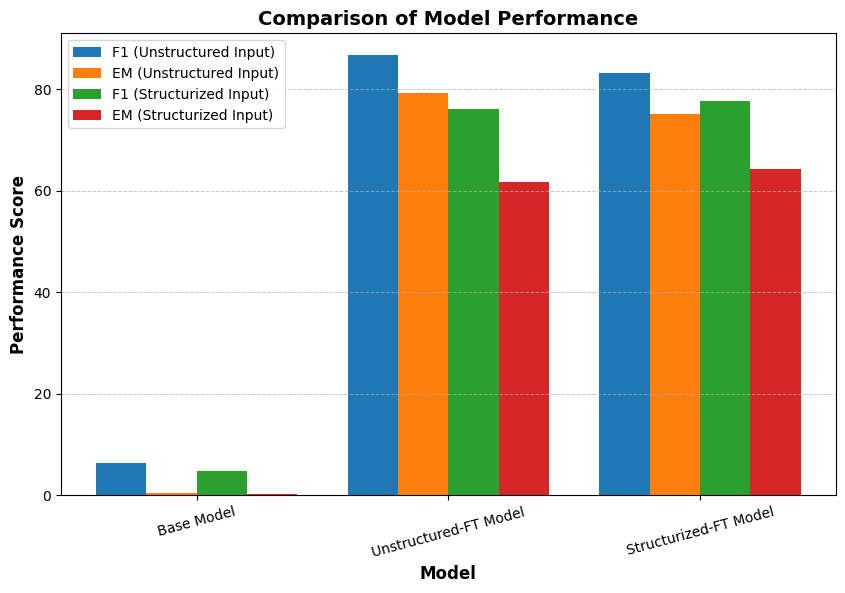

In [32]:
# Define metrics and models for plotting
metrics = [result_df.columns[i] for i in range(1, len(result_df.columns))]
x_labels = result_df["Model"]

# Bar Chart with Grouped Bars
fig, ax = plt.subplots(figsize=(10, 6))
width = 0.2  # Width of bars
x = np.arange(len(x_labels))  # X locations for groups

# Plot each metric
for i, metric in enumerate(metrics):
    ax.bar(x + i * width - (1.5 * width), result_df[metric], width=width, label=metric)

ax.set_xlabel("Model", fontsize=12, fontweight='bold')
ax.set_ylabel("Performance Score", fontsize=12, fontweight='bold')
ax.set_title("Comparison of Model Performance", fontsize=14, fontweight='bold')
ax.set_xticks(x)
ax.set_xticklabels(x_labels, rotation=15, fontsize=10)
ax.yaxis.grid(True, linestyle='--', linewidth=0.7, alpha=0.7) # Adding gridlines for clarity
ax.legend(frameon=True, fontsize=10) # Legend in APA style
plt.show()

### Radar Chart

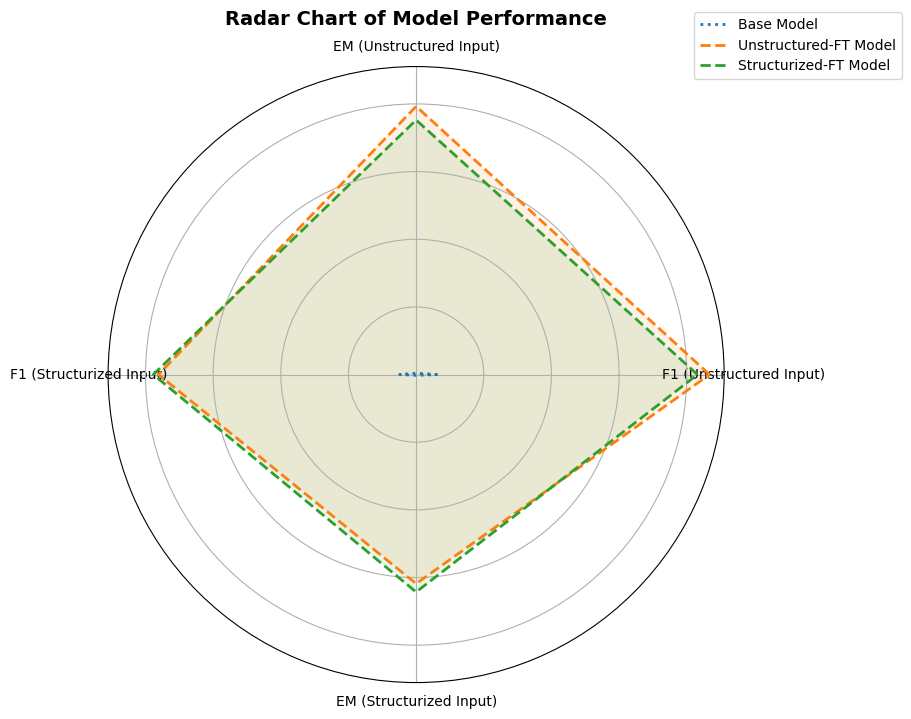

In [33]:
# Radar Chart Setup
labels = metrics  # Performance metrics as labels
num_vars = len(labels)

# Convert dataframe values into a format for the radar chart
values_base = result_df.iloc[0, 1:].values.tolist() + [result_df.iloc[0, 1]]  # Loop back to start
values_unstructured_ft = result_df.iloc[1, 1:].values.tolist() + [result_df.iloc[1, 1]]
values_structurized_ft = result_df.iloc[2, 1:].values.tolist() + [result_df.iloc[2, 1]]

angles = np.linspace(0, 2 * np.pi, num_vars, endpoint=False).tolist()
angles += angles[:1]  # Complete the loop

# Create Radar Chart
fig, ax = plt.subplots(figsize=(8, 8), subplot_kw=dict(polar=True))

ax.plot(angles, values_base, label="Base Model", linestyle='dotted', linewidth=2)
ax.fill(angles, values_base, alpha=0.1)

ax.plot(angles, values_unstructured_ft, label="Unstructured-FT Model", linestyle='dashed', linewidth=2)
ax.fill(angles, values_unstructured_ft, alpha=0.1)

ax.plot(angles, values_structurized_ft, label="Structurized-FT Model", linestyle='dashed', linewidth=2)
ax.fill(angles, values_structurized_ft, alpha=0.1)

ax.set_yticklabels([])  # Hide radial labels
ax.set_xticks(angles[:-1])
ax.set_xticklabels(labels, fontsize=10)
ax.set_title("Radar Chart of Model Performance", fontsize=14, fontweight='bold', pad=30)
ax.legend(loc="upper right", bbox_to_anchor=(1.3, 1.1))

plt.show()

# Basic Analysis

# Answer Prediction

In [34]:
# Define MultiIndex for columns
multiindex_answer_columns = pd.MultiIndex.from_tuples([
    ('OOD Gemini', 'Unstructured Context'),
    ('OOD Gemini', 'Structurized Context'),
    ('OOD Gemini', 'Real Answer'),
    ('Example 1', 'Unstructured Context'),
    ('Example 1', 'Structurized Context'),
    ('Example 1', 'Real Answer'),
    ('Example 2', 'Unstructured Context'),
    ('Example 2', 'Structurized Context'),
    ('Example 2', 'Real Answer'),
])

# Get predictions for the second question
answers_list_base = [qa_analyzer_base.get_prediction(question, context), qa_analyzer_base.get_prediction(question, structurized_context), ood_answer, qa_analyzer_base.get_prediction(example1_question, example1_context), qa_analyzer_base.get_prediction(example1_question, example1_structurized), example1_answer[0], qa_analyzer_base.get_prediction(example2_question, example2_context), qa_analyzer_base.get_prediction(example2_question, example2_structurized), example2_answer[1]]
answers_list_unstructured = [qa_analyzer_unstructured.get_prediction(question, context), qa_analyzer_unstructured.get_prediction(question, structurized_context), ood_answer, qa_analyzer_unstructured.get_prediction(example1_question, example1_context), qa_analyzer_unstructured.get_prediction(example1_question, example1_structurized), example1_answer[0], qa_analyzer_unstructured.get_prediction(example2_question, example2_context), qa_analyzer_unstructured.get_prediction(example2_question, example2_structurized), example2_answer[1]]
answers_list_structurized = [qa_analyzer_structurized.get_prediction(question, context), qa_analyzer_structurized.get_prediction(question, structurized_context), ood_answer, qa_analyzer_structurized.get_prediction(example1_question, example1_context), qa_analyzer_structurized.get_prediction(example1_question, example1_structurized), example1_answer[0], qa_analyzer_structurized.get_prediction(example2_question, example2_context), qa_analyzer_structurized.get_prediction(example2_question, example2_structurized), example2_answer[1]]

# Define data
multiindex_answer_data = [
    answers_list_base,
    answers_list_unstructured,
    answers_list_structurized
]

# Create DataFrame
answers_multiindex_df = pd.DataFrame(multiindex_answer_data, index=["Base Model", "Unstructured-FT Model", "Structurized-FT Model"], columns=multiindex_answer_columns)

# Apply Styling
styled_df = answers_multiindex_df.style.set_table_styles([
    # Center the first-level headers
    {'selector': 'th.col_heading.level0', 'props': [('text-align', 'center'), ('font-weight', 'bold'), ('font-size', '14px')]},
    # Add borders to the table
    {'selector': 'th, td', 'props': [('text-align', 'left'), ('border', '1px solid black'), ('padding', '5px')]},
    # Improve readability
    {'selector': 'thead th', 'props': [('background-color', '#f2f2f2'), ('color', 'black')]},
    # Set spacing for columns
    {'selector': 'table', 'props': [('border-collapse', 'collapse'), ('border-spacing', '10px')]}
])

styled_df

In [35]:
print("Unstructured Context")
print("Base model answer prediction:", qa_analyzer_base.get_prediction(question, context))
print("Unstructured-fine-tuned model answer prediction:", qa_analyzer_unstructured.get_prediction(question, context))
print("Structurized-fine-tuned model answer prediction:", qa_analyzer_structurized.get_prediction(question, context))

print("\nStructurized Context")
print("Base model answer prediction:", qa_analyzer_base.get_prediction(question, structurized_context))
print("Unstructured-fine-tuned model answer prediction:", qa_analyzer_unstructured.get_prediction(question, structurized_context))
print("Structurized-fine-tuned model answer prediction:", qa_analyzer_structurized.get_prediction(question, structurized_context))

Unstructured Context
Base model answer prediction: 
Unstructured-fine-tuned model answer prediction: deforestation
Structurized-fine-tuned model answer prediction: deforestation

Structurized Context
Base model answer prediction: 
Unstructured-fine-tuned model answer prediction: Deforestation
Structurized-fine-tuned model answer prediction: Deforestation


In [36]:
print("Unstructured Context")
print("Base model answer prediction:", qa_analyzer_base.get_prediction(example1_question, example1_context))
print("Unstructured-fine-tuned model answer prediction:", qa_analyzer_unstructured.get_prediction(example1_question, example1_context))
print("Structurized-fine-tuned model answer prediction:", qa_analyzer_structurized.get_prediction(example1_question, example1_context))

print("\nStructurized Context")
print("Base model answer prediction:", qa_analyzer_base.get_prediction(example1_question, example1_structurized))
print("Unstructured-fine-tuned model answer prediction:", qa_analyzer_unstructured.get_prediction(example1_question, example1_structurized))
print("Structurized-fine-tuned model answer prediction:", qa_analyzer_structurized.get_prediction(example1_question, example1_structurized))

Unstructured Context
Base model answer prediction: 
Unstructured-fine-tuned model answer prediction: Do not leave seeds in diseased fields and nearby rice fields. Choose healthy rice and eliminate diseased, dead, and injured rice. 2. Seed disinfection. Before sowing, soak the seeds with 25 % 100g ( Xibok ) EC 3000 times liquid for 1 to 2 days, or take 20 grams of 17 % Dexinqing wettable powder for every 6 kilograms of rice seeds. Soak the seeds in 8 kg of water for 60 hours. 3. Deal with diseased rice straw
Structurized-fine-tuned model answer prediction: 

Structurized Context
Base model answer prediction: 
Unstructured-fine-tuned model answer prediction: 
Structurized-fine-tuned model answer prediction: diseased fields and nearby rice fields


In [37]:
print("Unstructured Context")
print("Base model answer prediction:", qa_analyzer_base.get_prediction(example2_question, example2_context))
print("Unstructured-fine-tuned model answer prediction:", qa_analyzer_unstructured.get_prediction(example2_question, example2_context))
print("Structurized-fine-tuned model answer prediction:", qa_analyzer_structurized.get_prediction(example2_question, example2_context))

print("\nStructurized Context")
print("Base model answer prediction:", qa_analyzer_base.get_prediction(example2_question, example2_structurized))
print("Unstructured-fine-tuned model answer prediction:", qa_analyzer_unstructured.get_prediction(example2_question, example2_structurized))
print("Structurized-fine-tuned model answer prediction:", qa_analyzer_structurized.get_prediction(example2_question, example2_structurized))

Unstructured Context
Base model answer prediction: 
Unstructured-fine-tuned model answer prediction: temperature
Structurized-fine-tuned model answer prediction: unimodal curve

Structurized Context
Base model answer prediction: 
Unstructured-fine-tuned model answer prediction: unimodal curve
Structurized-fine-tuned model answer prediction: unimodal curve


# Attention Visualization - Grid

Through grid visualization of all heads and layers, it is possible to see the overall attention pattern changes.

## Base Model

BertSdpaSelfAttention is used but `torch.nn.functional.scaled_dot_product_attention` does not support non-absolute `position_embedding_type` or `output_attentions=True` or `head_mask`. Falling back to the manual attention implementation, but specifying the manual implementation will be required from Transformers version v5.0.0 onwards. This warning can be removed using the argument `attn_implementation="eager"` when loading the model.


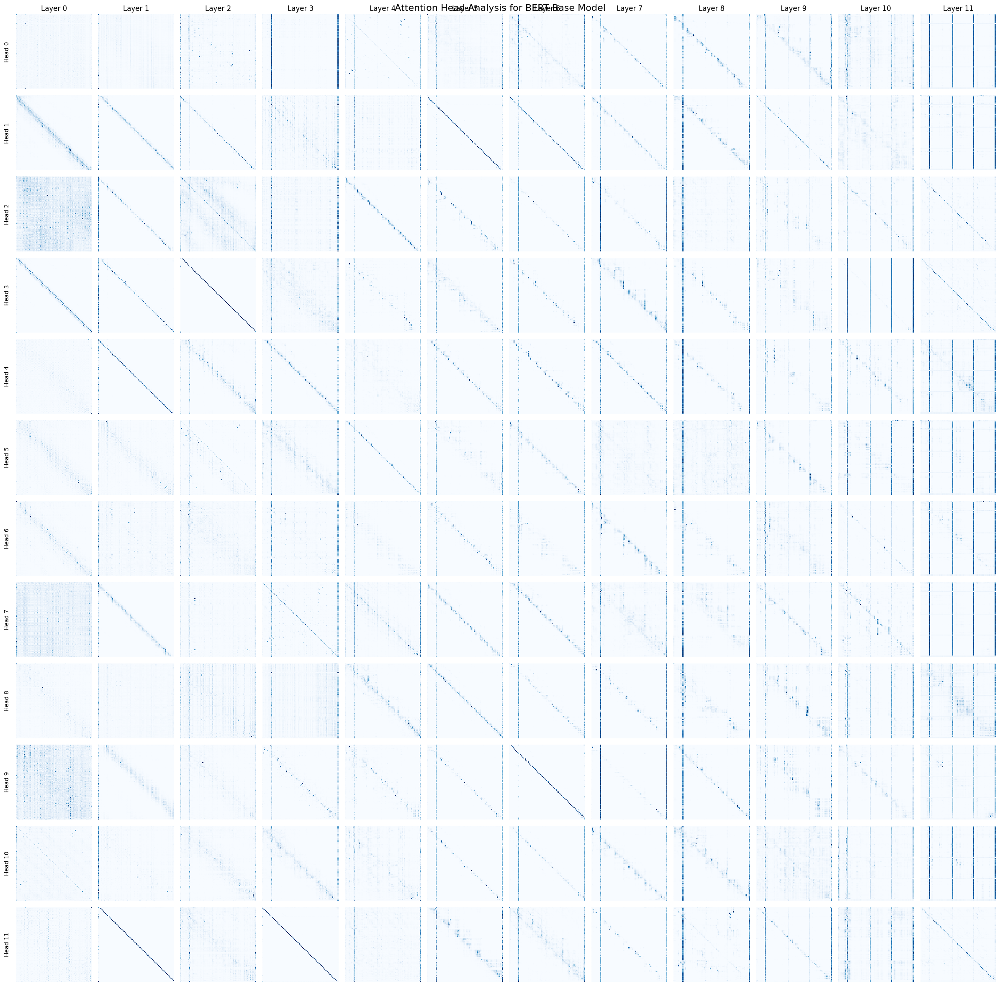

In [38]:
qa_analyzer_base.visualize_attention_grid(question, context)

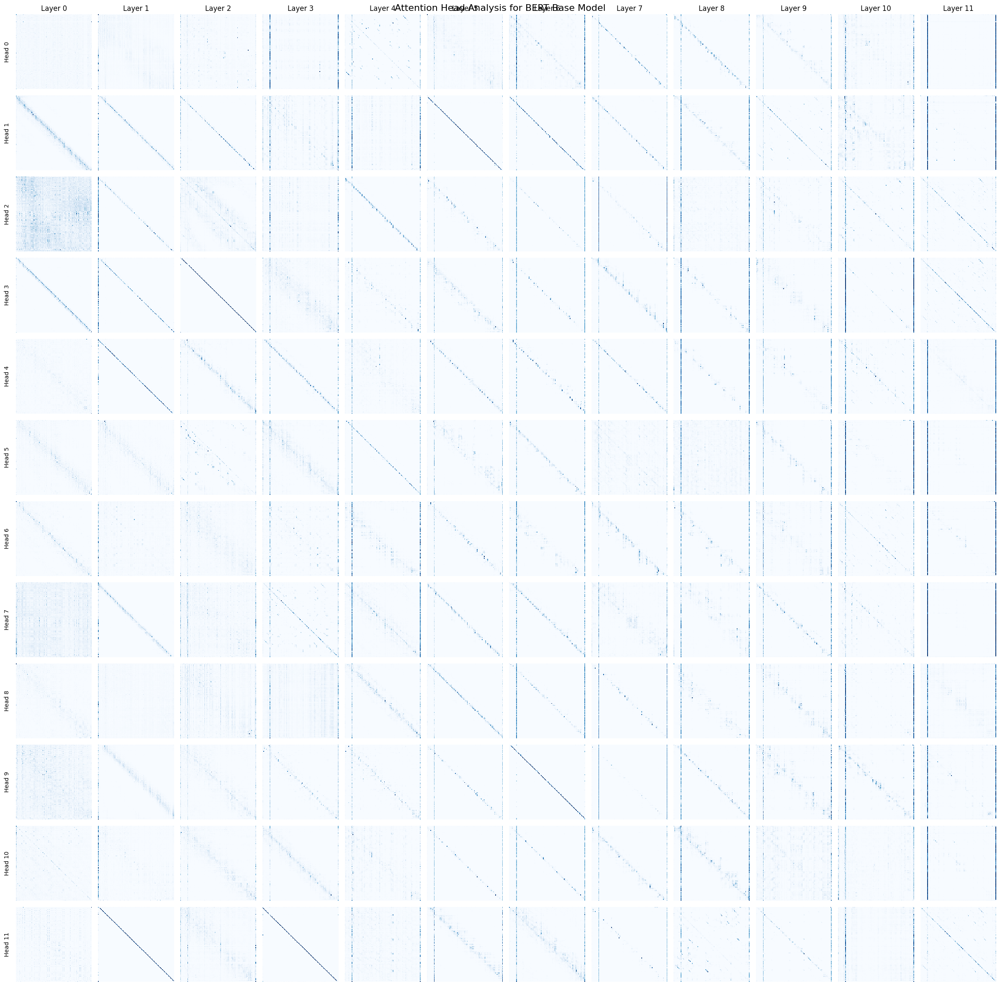

In [39]:
qa_analyzer_base.visualize_attention_grid(question, structurized_context)

## Unstructured Fine-Tuned BERT Model

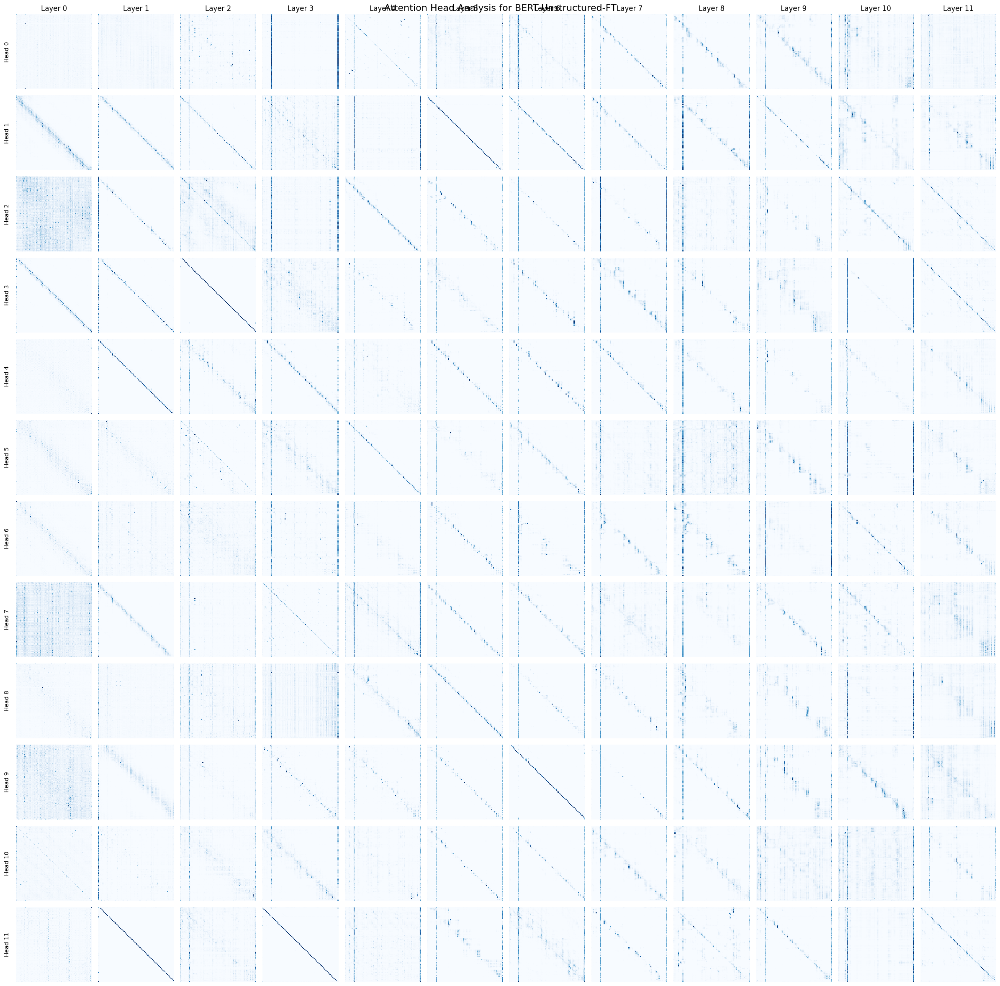

In [40]:
qa_analyzer_unstructured.visualize_attention_grid(question, context)

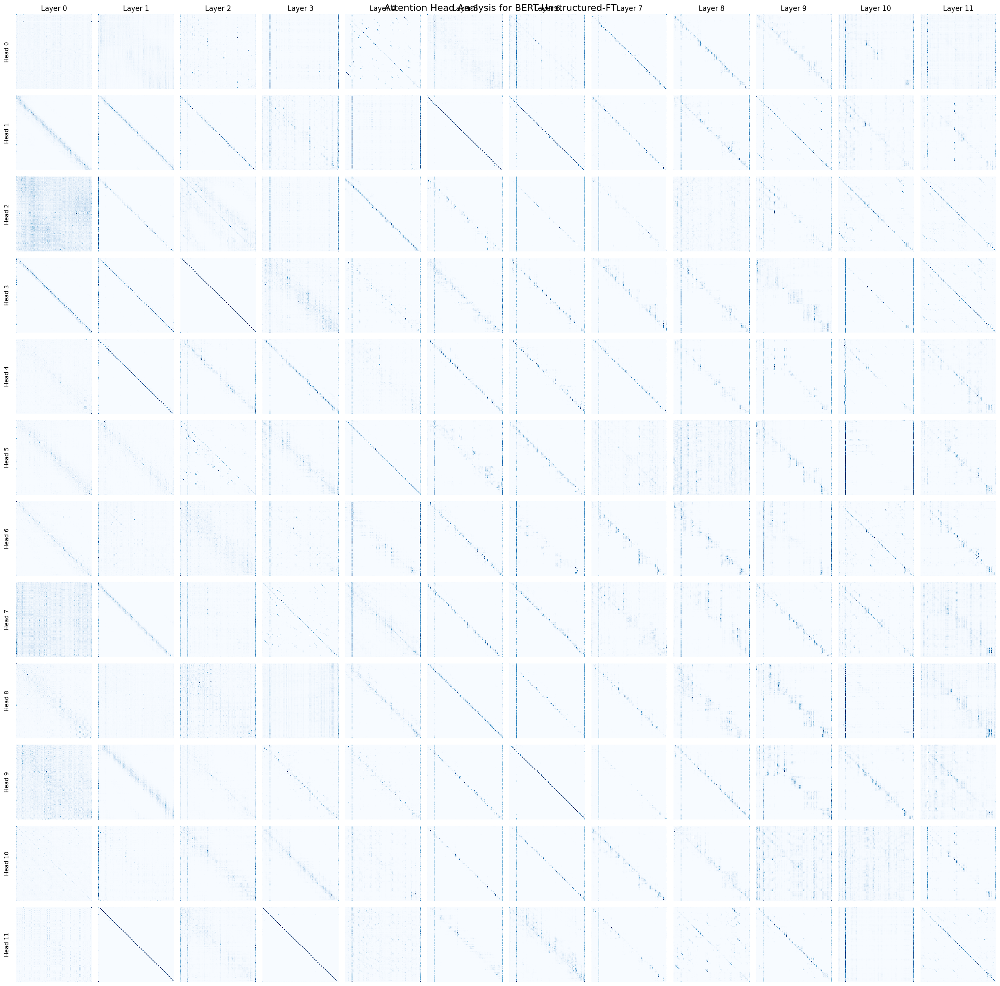

In [41]:
qa_analyzer_unstructured.visualize_attention_grid(question, structurized_context)

## Structurized Fine-Tuned BERT Model

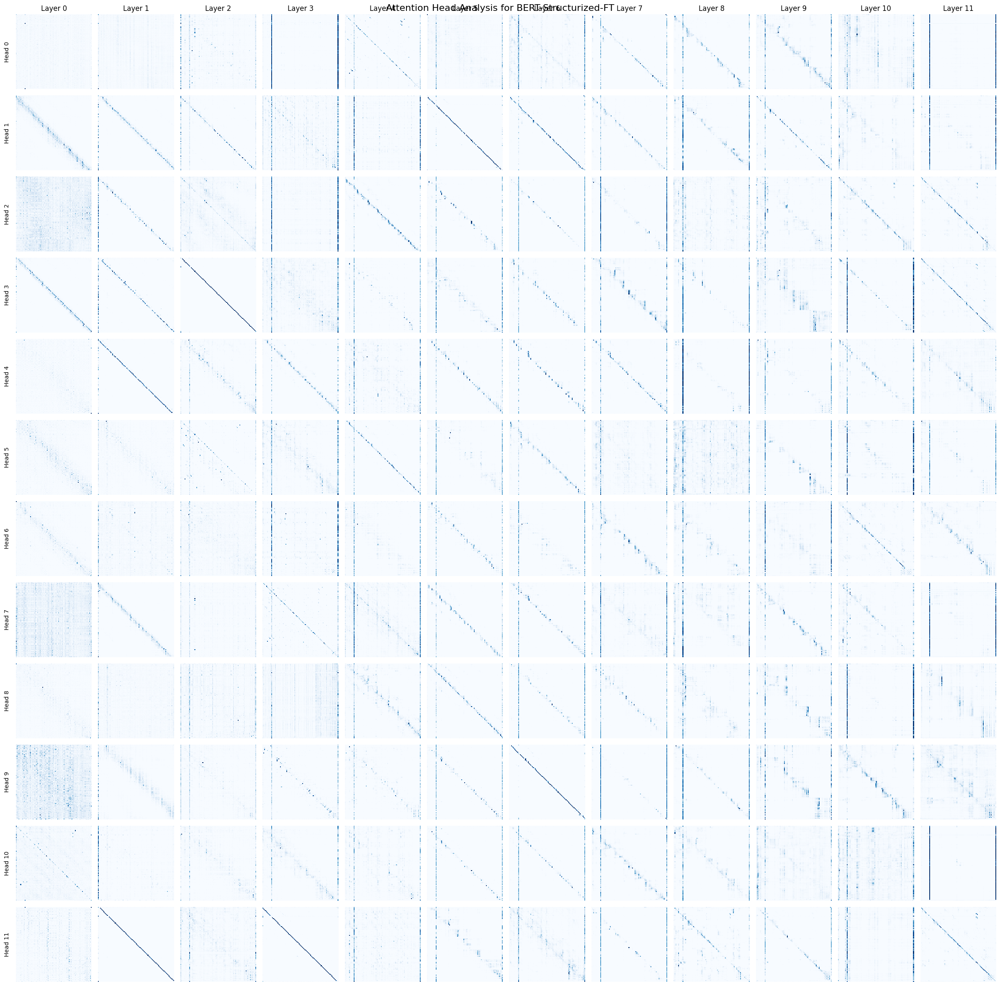

In [42]:
qa_analyzer_structurized.visualize_attention_grid(question, context)

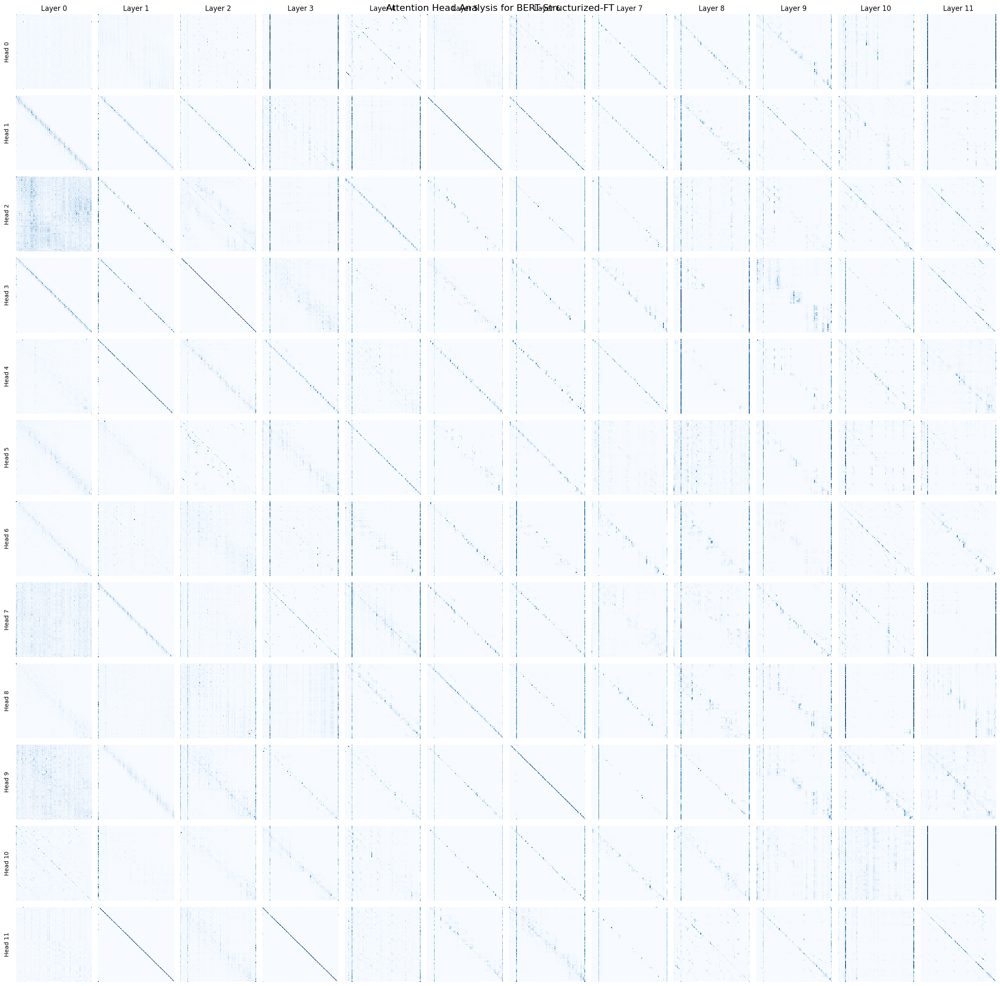

In [43]:
qa_analyzer_structurized.visualize_attention_grid(question, structurized_context)

# Attention Visualization - Interactive

Through interactive graphs, it is possible to observe attentions in more detail.

## Base Model

In [44]:
qa_analyzer_base.interactive_attention_visualization(question, context)

interactive(children=(IntSlider(value=11, description='Layer', max=11), IntSlider(value=8, description='Head',…

In [45]:
qa_analyzer_base.interactive_attention_visualization(question, structurized_context)

interactive(children=(IntSlider(value=11, description='Layer', max=11), IntSlider(value=8, description='Head',…

## Unstructured-FT Model

In [46]:
qa_analyzer_unstructured.interactive_attention_visualization(question, context)

interactive(children=(IntSlider(value=11, description='Layer', max=11), IntSlider(value=8, description='Head',…

In [47]:
qa_analyzer_unstructured.interactive_attention_visualization(question, structurized_context)

interactive(children=(IntSlider(value=11, description='Layer', max=11), IntSlider(value=8, description='Head',…

## Structurized-FT Model

In [48]:
qa_analyzer_structurized.interactive_attention_visualization(question, context)

interactive(children=(IntSlider(value=11, description='Layer', max=11), IntSlider(value=8, description='Head',…

In [49]:
qa_analyzer_structurized.interactive_attention_visualization(question, structurized_context)

interactive(children=(IntSlider(value=11, description='Layer', max=11), IntSlider(value=8, description='Head',…

# Prepare Data for Analysis

This section is not needed anymore, attentions and hidden states are obtained and used in calculations and visualizations implicitly within QAModelAnalyzer class implementation.

Though, explicit extraction of attention and hidden states is **not required** anymore to conduct Jensen-Shannon Divergence (JSD) between models to determine how different they are from each other.

In [50]:
# #@title Attention Scores & Hidden States for Unstructured Context
# base_attn_uns = qa_analyzer_base.get_attention_scores(question, context)
# uns_attn_uns = qa_analyzer_unstructured.get_attention_scores(question, context)
# str_attn_uns = qa_analyzer_structurized.get_attention_scores(question, context)

# base_hddn_uns = qa_analyzer_base.get_hidden_states(question, context)
# uns_hddn_uns = qa_analyzer_unstructured.get_hidden_states(question, context)
# str_hddn_uns = qa_analyzer_structurized.get_hidden_states(question, context)

In [51]:
# #@title Attention Scores & Hidden States for Structurized Context
# base_attn_str = qa_analyzer_base.get_attention_scores(question, structurized_context)
# uns_attn_str = qa_analyzer_unstructured.get_attention_scores(question, structurized_context)
# str_attn_str = qa_analyzer_structurized.get_attention_scores(question, structurized_context)

# base_hddn_str = qa_analyzer_base.get_hidden_states(question, structurized_context)
# uns_hddn_str = qa_analyzer_unstructured.get_hidden_states(question, structurized_context)
# str_hddn_str = qa_analyzer_structurized.get_hidden_states(question, structurized_context)

# Representational Similarity Analysis

##### Old calculations based on RSAToolBox library

In [52]:
# hidden_states_base = qa_analyzer_base.get_hidden_states(question, context)
# hidden_states_unstructured = qa_analyzer_unstructured.get_hidden_states(question, context)
# hidden_states_structurized = qa_analyzer_structurized.get_hidden_states(question, context)

In [53]:
# print(hidden_states_base.shape)
# print(hidden_states_unstructured.shape)
# print(hidden_states_structurized.shape)

In [54]:
# # Assuming 'output.hidden_states' is a list of tensors, each representing a layer's hidden states
# num_layers = len(hidden_states_base) # not important, length is the same in every model; i.e., 12
# layer_names = ["Embedding", "Encoder Layer 0", "Encoder Layer 1", "Encoder Layer 2", "Encoder Layer 3", "Encoder Layer 4", "Encoder Layer 5", "Encoder Layer 6", "Encoder Layer 7", "Encoder Layer 8", "Encoder Layer 9", "Encoder Layer 10", "Encoder Layer 11"]

In [55]:
# model_features_base = {layer_name : layer_hidden_state.squeeze(0) for layer_name, layer_hidden_state in zip(layer_names, hidden_states_base)}
# rdms_base, rdms_base_dict = calc_rdms(model_features_base, method='correlation')
# rdms_base

In [56]:
# model_features_unstructured = {layer_name : layer_hidden_state.squeeze(0) for layer_name, layer_hidden_state in zip(layer_names, hidden_states_unstructured)}
# rdms_unstructured, rdms_unstructured_dict = calc_rdms(model_features_unstructured, method='correlation')
# rdms_unstructured

In [57]:
# model_features_structurized = {layer_name : layer_hidden_state.squeeze(0) for layer_name, layer_hidden_state in zip(layer_names, hidden_states_structurized)}
# rdms_structurized, rdms_structurized_dict = calc_rdms(model_features_structurized, method='correlation')
# rdms_structurized

In [58]:
# plot_maps(rdms_base_dict, "BERT Base")

In [59]:
# plot_maps(rdms_unstructured_dict, "BERT Unstructured")

In [60]:
# plot_maps(rdms_structurized_dict, "BERT Structurized")

## RSA on Attentions

### Base Model

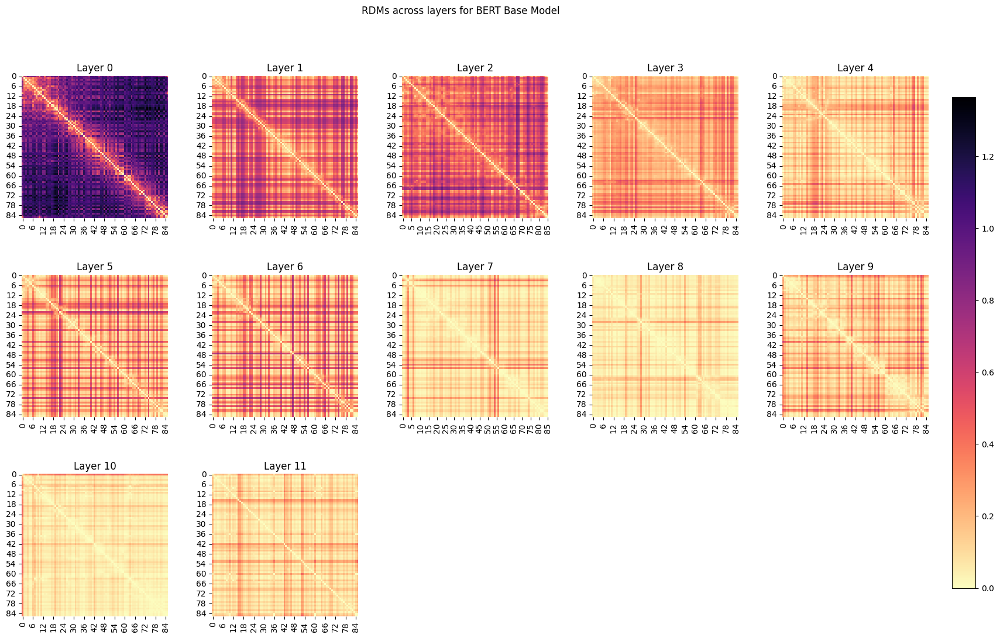

In [61]:
qa_analyzer_base.rsa_analysis_visualization('attention', question, context, method='correlation')

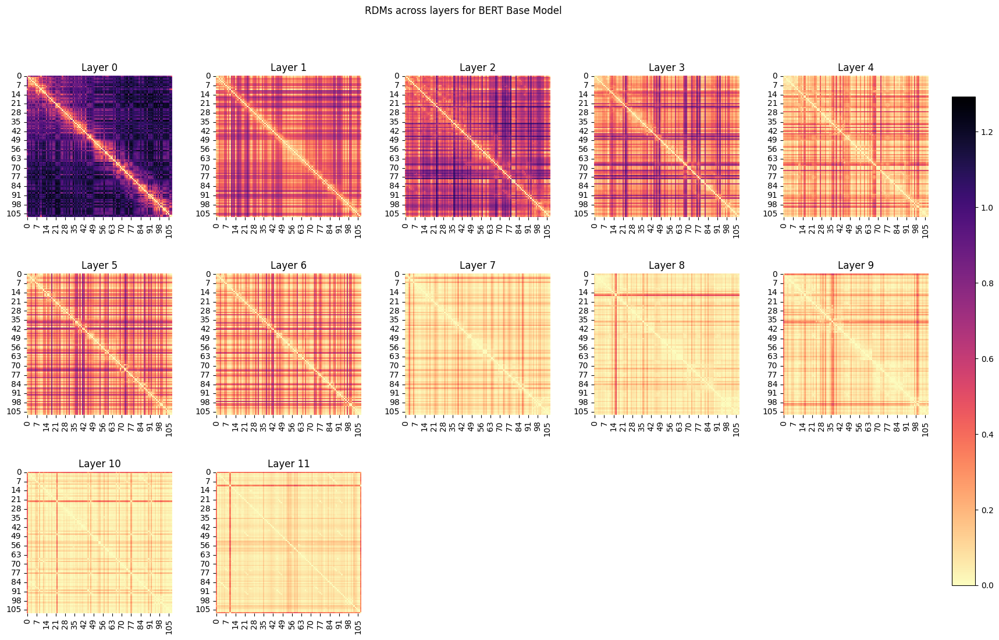

In [62]:
qa_analyzer_base.rsa_analysis_visualization('attention', question, structurized_context, method='correlation')

### Unstructured-FT Model

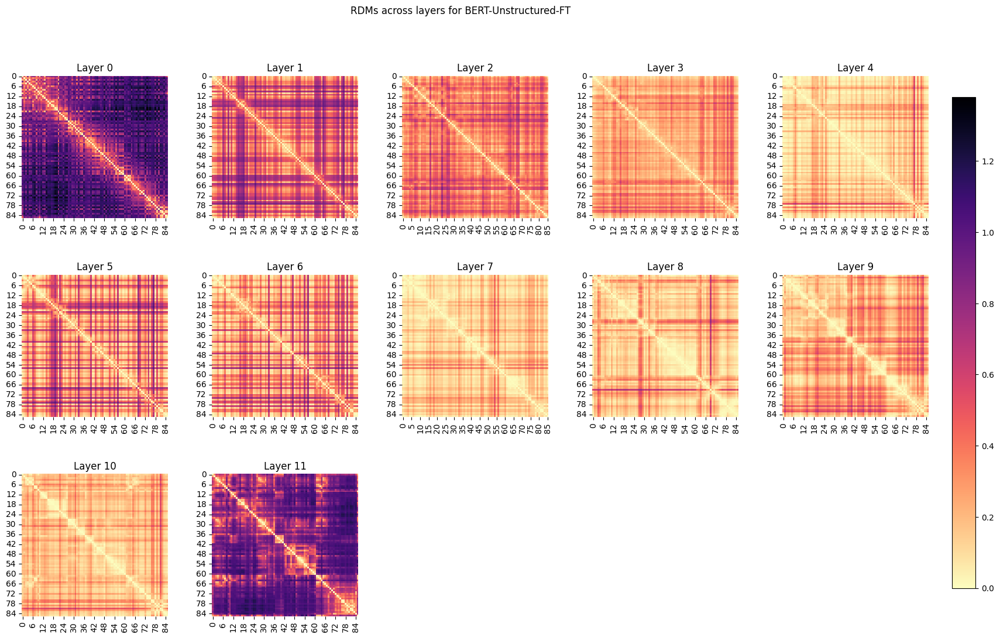

In [63]:
qa_analyzer_unstructured.rsa_analysis_visualization('attention', question, context, method='correlation')

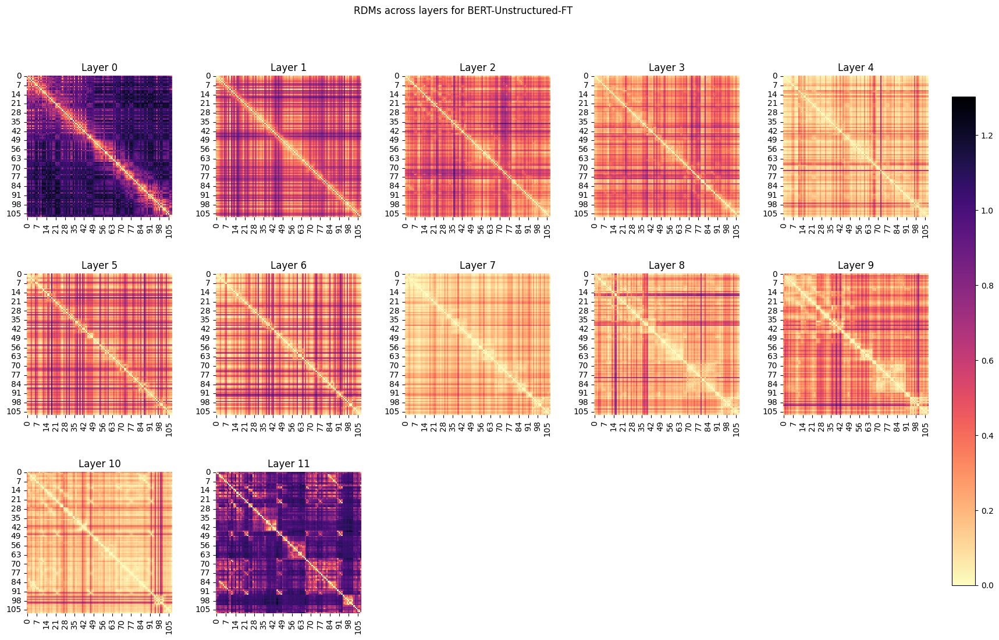

In [64]:
qa_analyzer_unstructured.rsa_analysis_visualization('attention', question, structurized_context, method='correlation')

### Structurized-FT Model

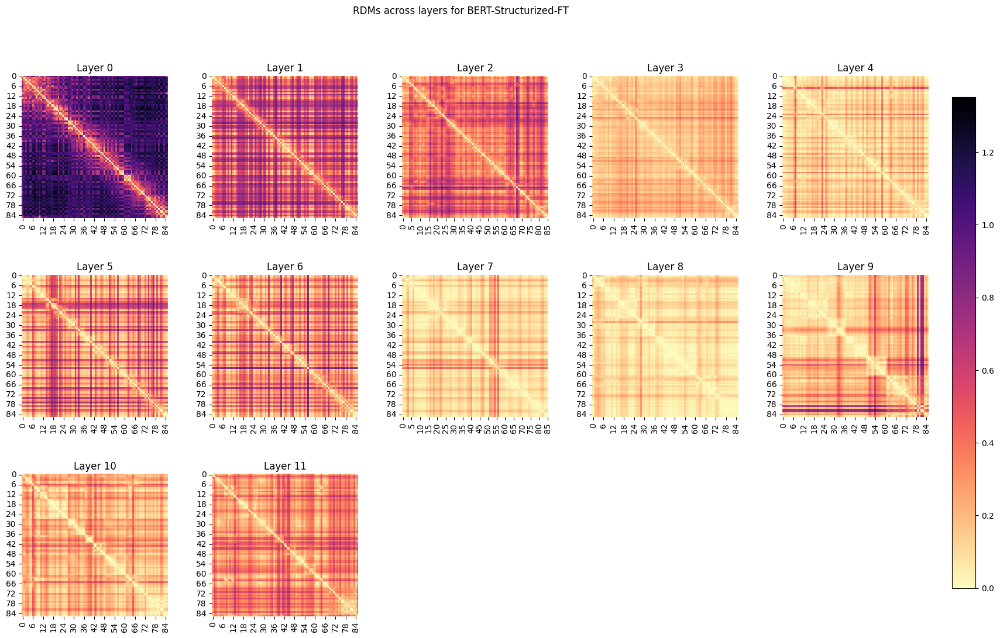

In [65]:
qa_analyzer_structurized.rsa_analysis_visualization('attention', question, context, method='correlation')

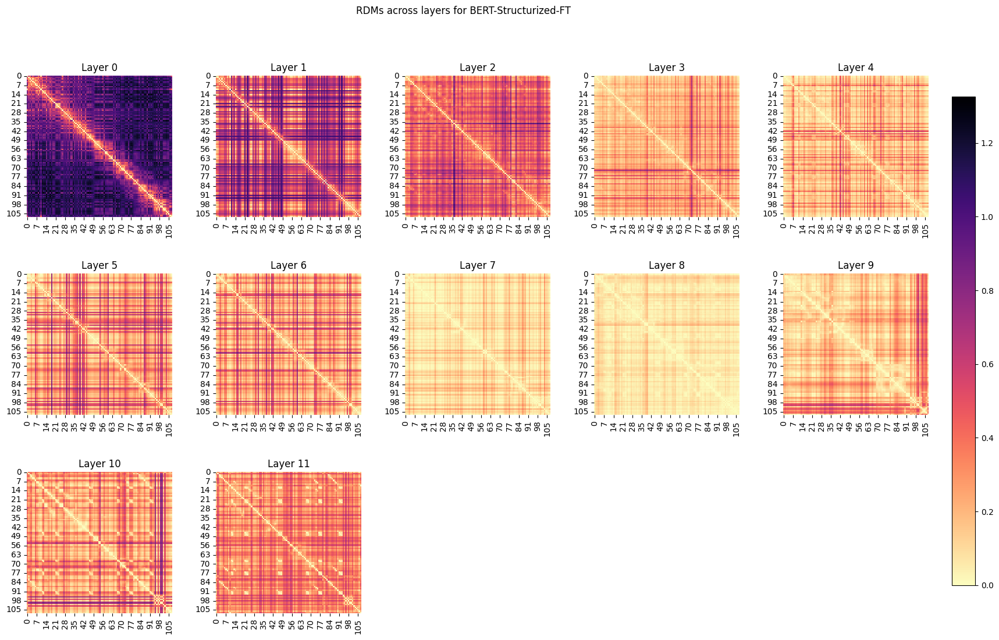

In [66]:
qa_analyzer_structurized.rsa_analysis_visualization('attention', question, structurized_context, method='correlation')

## RSA on Hidden States

### Base Model

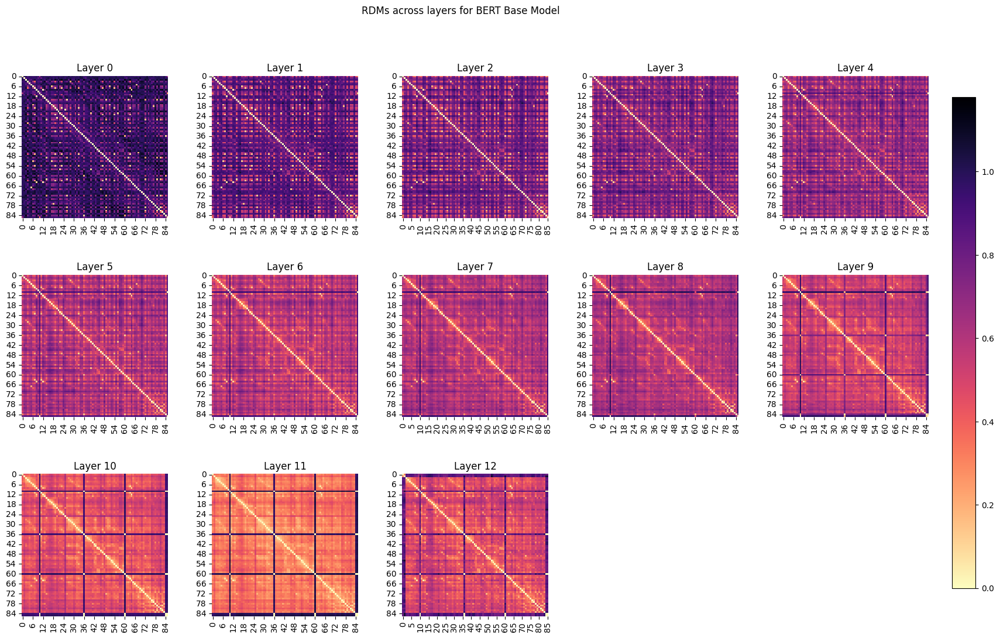

In [67]:
qa_analyzer_base.rsa_analysis_visualization('hidden_states', question, context, method='correlation')

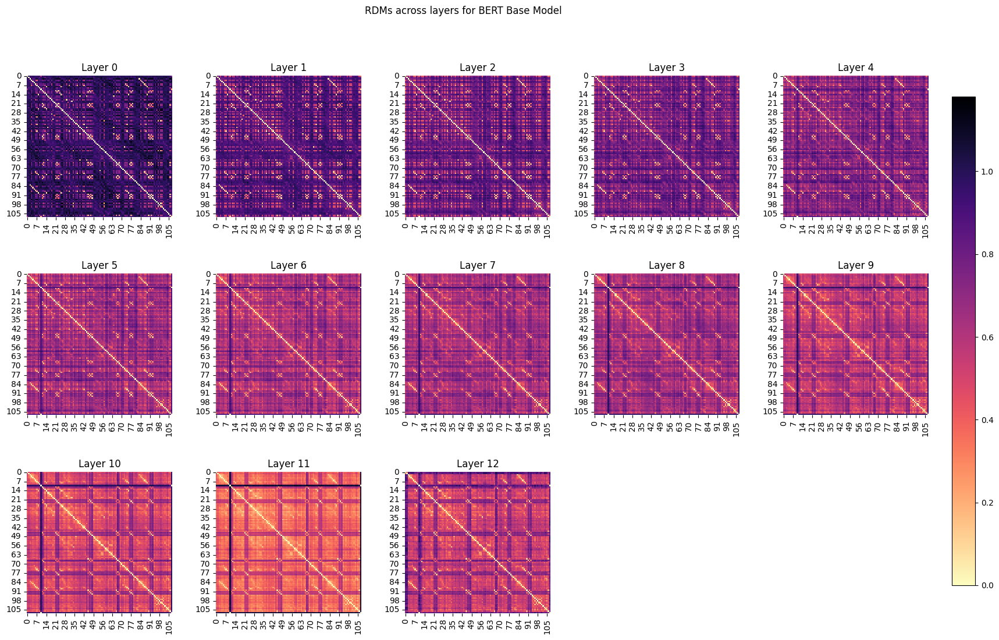

In [68]:
qa_analyzer_base.rsa_analysis_visualization('hidden_states', question, structurized_context, method='correlation')

### Unstructured-FT Model

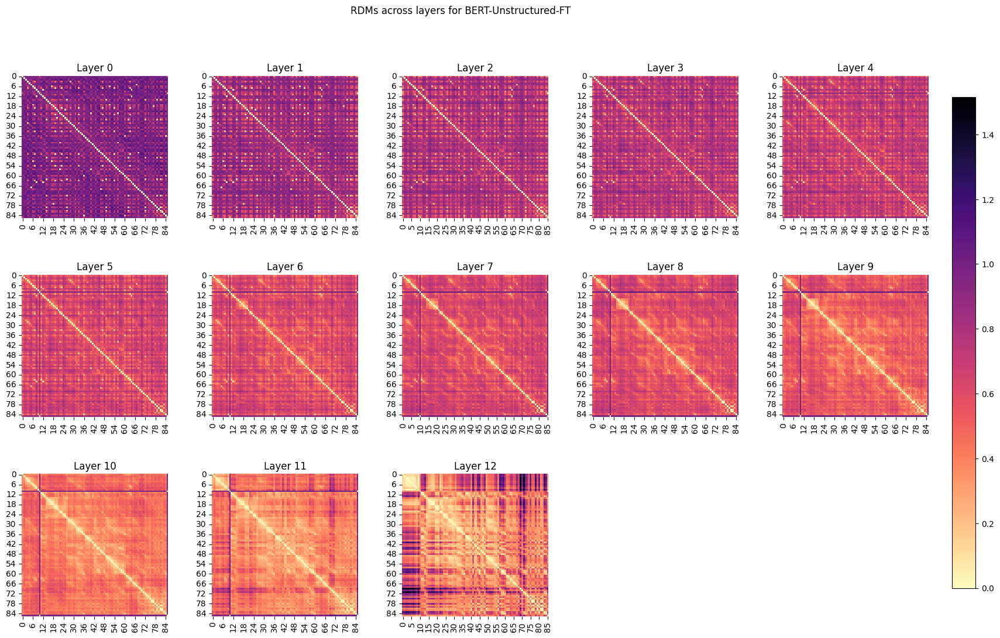

In [69]:
qa_analyzer_unstructured.rsa_analysis_visualization('hidden_states', question, context, method='correlation')

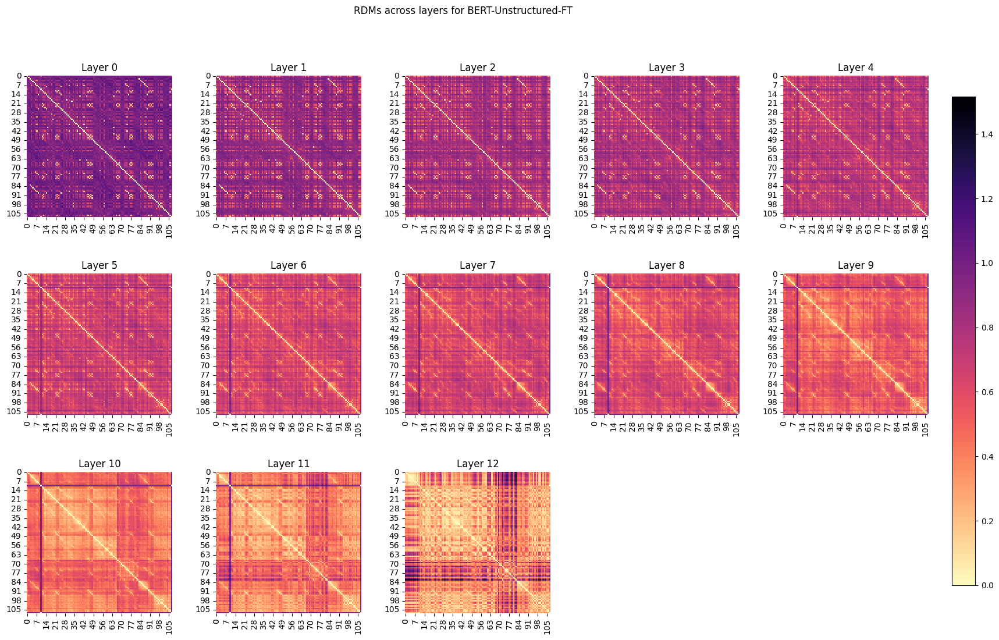

In [70]:
qa_analyzer_unstructured.rsa_analysis_visualization('hidden_states', question, structurized_context, method='correlation')

### Structurized-FT Model

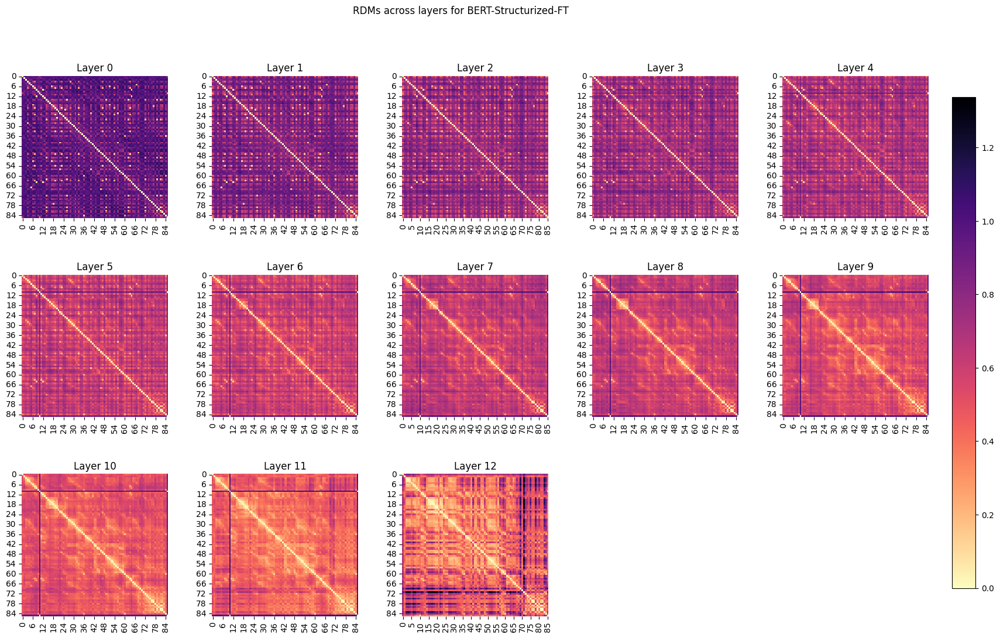

In [71]:
qa_analyzer_structurized.rsa_analysis_visualization('hidden_states', question, context, method='correlation')

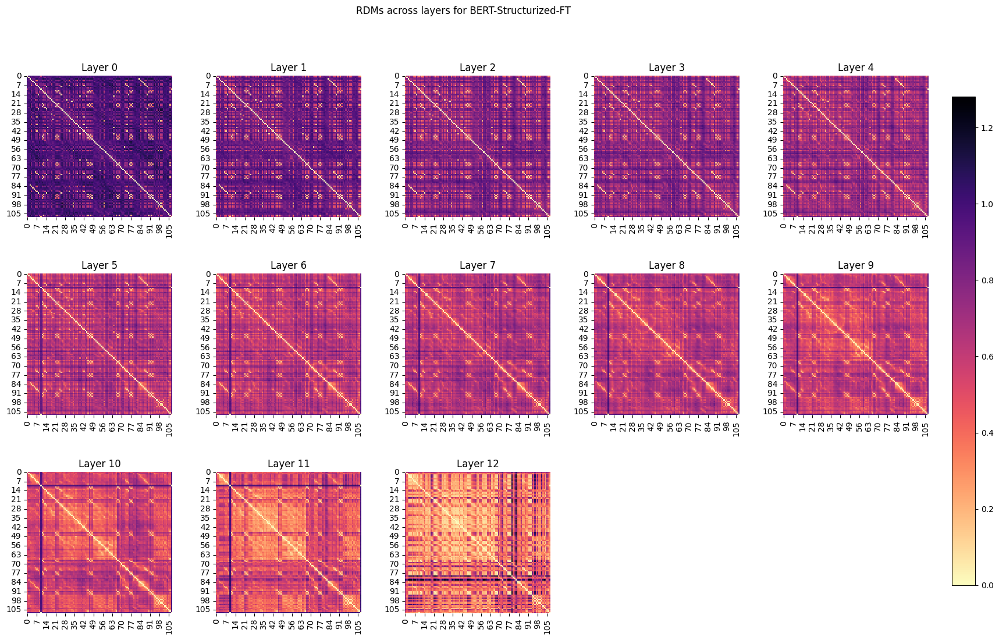

In [72]:
qa_analyzer_structurized.rsa_analysis_visualization('hidden_states', question, structurized_context, method='correlation')

# EXPERIMENT 1: COMPARING MODELS FOR THE SAME INPUT FORMAT

In [73]:
comparator1 = QAModelComparator(qa_analyzer_unstructured, qa_analyzer_base)
comparator2 = QAModelComparator(qa_analyzer_structurized, qa_analyzer_base)
comparator3 = QAModelComparator(qa_analyzer_unstructured, qa_analyzer_structurized)

## Unstructured Input Format

### on Attention Scores

#### JSD

In [74]:
comparator1.compare_layerwise_jsd(question, context, "attention")

{0: 0.05730046524422548,
 1: 0.10618664749742192,
 2: 0.11808995030784641,
 3: 0.09517525137792836,
 4: 0.12852002596670084,
 5: 0.13389012171369688,
 6: 0.1351768655220348,
 7: 0.16065993888194605,
 8: 0.21697001967708368,
 9: 0.27750089195996586,
 10: 0.3540401917386292,
 11: 0.4979583209776084}

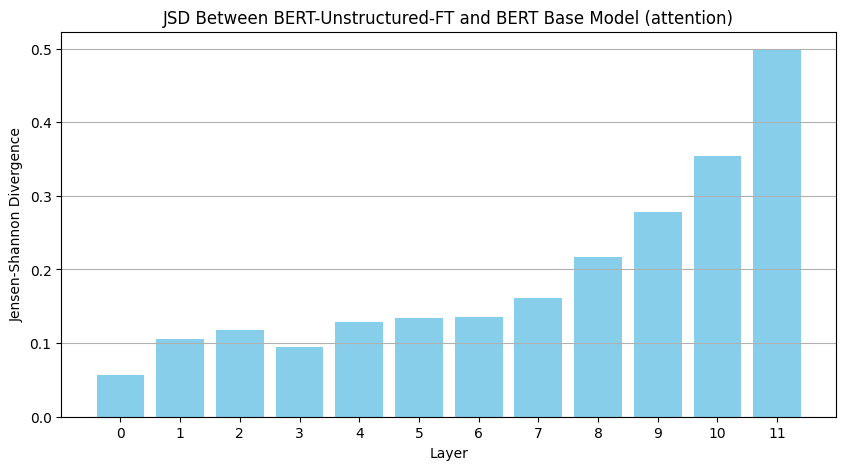

In [75]:
comparator1.plot_jsd(question, context, "attention")

In [76]:
comparator2.compare_layerwise_jsd(question, context, "attention")

{0: 0.06325895384075363,
 1: 0.09746080940464832,
 2: 0.11394497884784857,
 3: 0.10524064350331046,
 4: 0.1298193805643803,
 5: 0.13480798819316595,
 6: 0.13400611251578257,
 7: 0.13741762689664824,
 8: 0.20075378785484138,
 9: 0.2838280519462202,
 10: 0.3745398662496028,
 11: 0.4181089438505465}

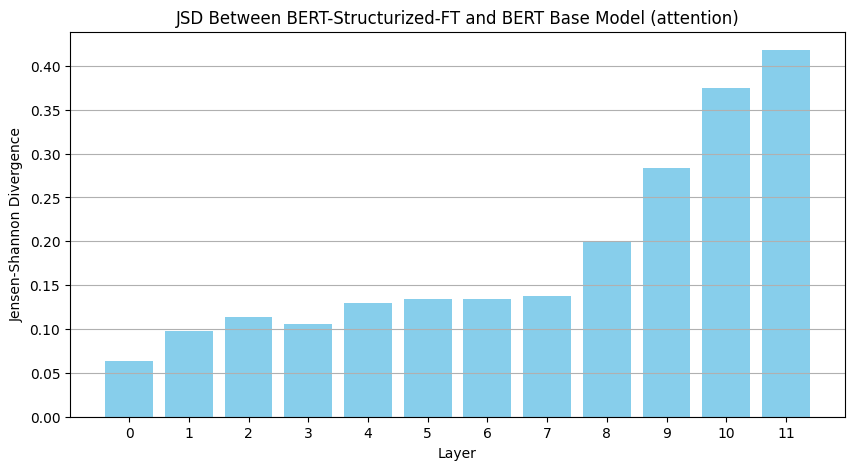

In [77]:
comparator2.plot_jsd(question, context, "attention")

In [78]:
comparator3.compare_layerwise_jsd(question, context, "attention")

{0: 0.07028808975127097,
 1: 0.10908012508492829,
 2: 0.1021853241507608,
 3: 0.11786838418655035,
 4: 0.13359555094862396,
 5: 0.1313904139619771,
 6: 0.132823258480669,
 7: 0.1454420402251815,
 8: 0.1708762398818489,
 9: 0.17587584857679836,
 10: 0.1638919112125262,
 11: 0.33023076838822985}

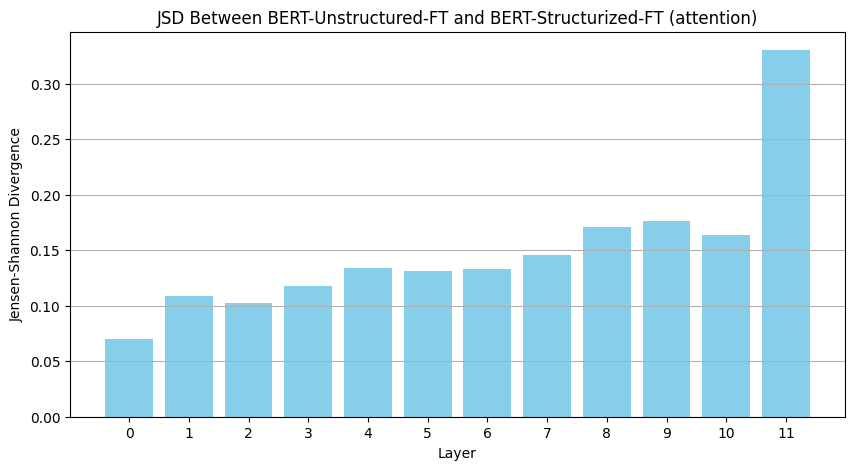

In [79]:
comparator3.plot_jsd(question, context, "attention")

#### RSA

In [80]:
comparator1.compare_rsa(question, context, method="correlation", representation_type = "attention")

{0: array([[0.00000000e+00, 1.02893833e-01, 4.16966506e-01, ...,
         1.82770682e-04, 4.42299788e-02, 7.72591402e-02],
        [1.02893833e-01, 0.00000000e+00, 9.33717225e-02, ...,
         3.58820067e-02, 5.90073708e-02, 1.43316042e-02],
        [4.16966506e-01, 9.33717225e-02, 0.00000000e+00, ...,
         7.22785233e-03, 9.16126974e-02, 1.13047211e-01],
        ...,
        [1.82770682e-04, 3.58820067e-02, 7.22785233e-03, ...,
         0.00000000e+00, 7.85881740e-02, 2.95315562e-02],
        [4.42299788e-02, 5.90073708e-02, 9.16126974e-02, ...,
         7.85881740e-02, 0.00000000e+00, 5.01323659e-02],
        [7.72591402e-02, 1.43316042e-02, 1.13047211e-01, ...,
         2.95315562e-02, 5.01323659e-02, 0.00000000e+00]]),
 1: array([[0.        , 0.01441139, 0.14402075, ..., 0.05900137, 0.07983434,
         0.0087045 ],
        [0.01441139, 0.        , 0.11775467, ..., 0.09278289, 0.09105774,
         0.02015998],
        [0.14402075, 0.11775467, 0.        , ..., 0.21020808, 0.175

C:\Users\proxi\AppData\Local\Temp\ipykernel_44408\88738578.py:175: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])


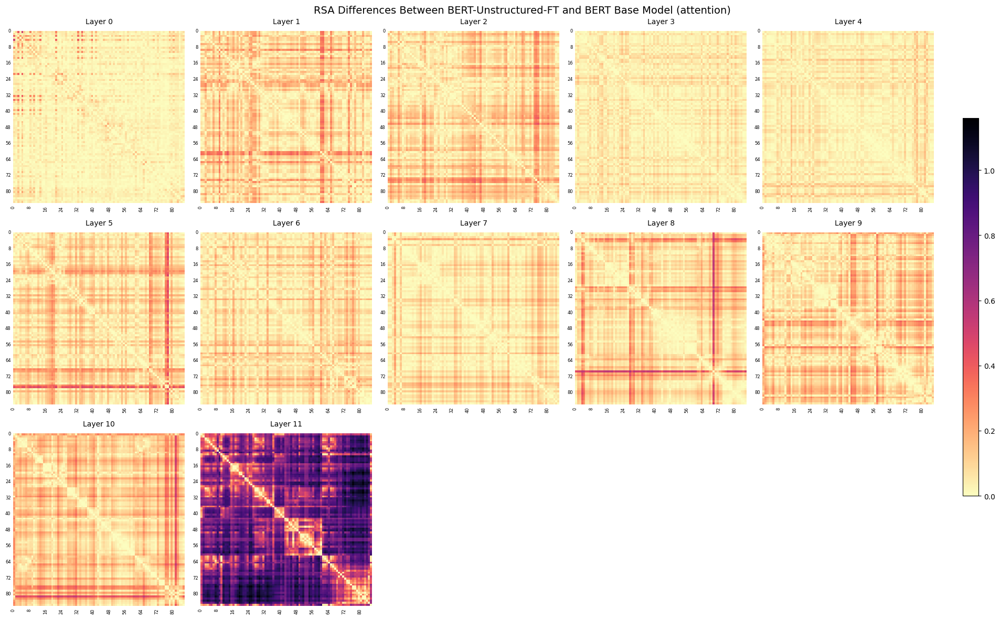

In [81]:
comparator1.plot_rsa(question, context, method="correlation", representation_type = "attention")

In [82]:
comparator2.compare_rsa(question, context, method="correlation", representation_type = "attention")

{0: array([[0.        , 0.01203402, 0.19146476, ..., 0.0315125 , 0.02547426,
         0.10951684],
        [0.01203402, 0.        , 0.10632765, ..., 0.04394343, 0.04269702,
         0.02698264],
        [0.19146476, 0.10632765, 0.        , ..., 0.036371  , 0.00692025,
         0.00304682],
        ...,
        [0.0315125 , 0.04394343, 0.036371  , ..., 0.        , 0.04816857,
         0.05841321],
        [0.02547426, 0.04269702, 0.00692025, ..., 0.04816857, 0.        ,
         0.00211675],
        [0.10951684, 0.02698264, 0.00304682, ..., 0.05841321, 0.00211675,
         0.        ]]),
 1: array([[0.        , 0.01620458, 0.03625209, ..., 0.01797257, 0.04292689,
         0.00346533],
        [0.01620458, 0.        , 0.03135832, ..., 0.02530231, 0.05135351,
         0.01737317],
        [0.03625209, 0.03135832, 0.        , ..., 0.03764347, 0.04919788,
         0.03022949],
        ...,
        [0.01797257, 0.02530231, 0.03764347, ..., 0.        , 0.02860045,
         0.01003839],
      

C:\Users\proxi\AppData\Local\Temp\ipykernel_44408\88738578.py:175: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])


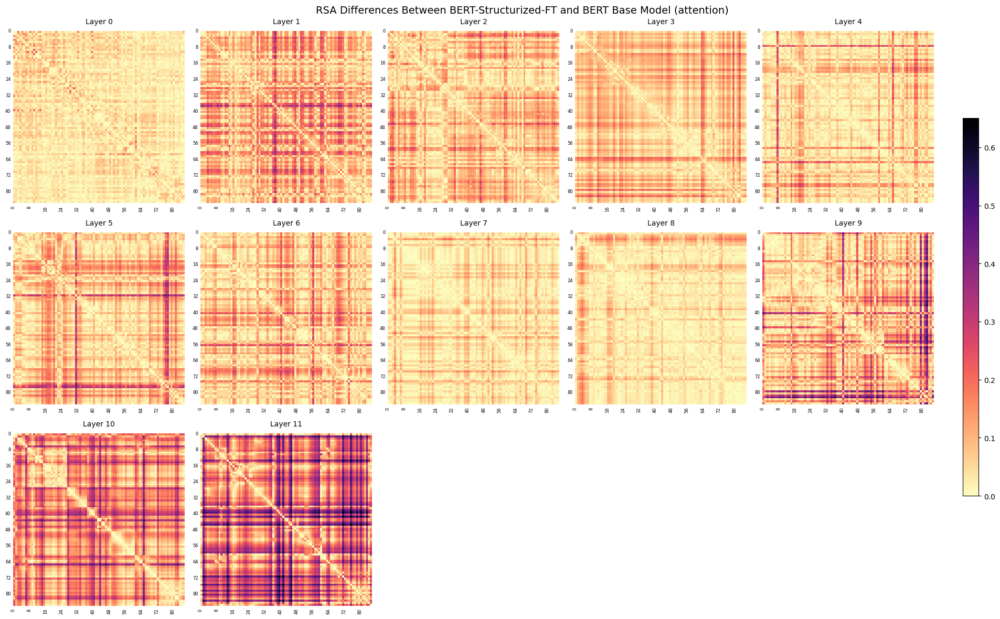

In [83]:
comparator2.plot_rsa(question, context, method="correlation", representation_type = "attention")

In [84]:
comparator3.compare_rsa(question, context, method="correlation", representation_type = "attention")

{0: array([[0.        , 0.09085981, 0.22550174, ..., 0.03132973, 0.06970424,
         0.0322577 ],
        [0.09085981, 0.        , 0.01295592, ..., 0.00806142, 0.01631035,
         0.04131424],
        [0.22550174, 0.01295592, 0.        , ..., 0.04359886, 0.09853295,
         0.11609403],
        ...,
        [0.03132973, 0.00806142, 0.04359886, ..., 0.        , 0.12675674,
         0.08794476],
        [0.06970424, 0.01631035, 0.09853295, ..., 0.12675674, 0.        ,
         0.04801562],
        [0.0322577 , 0.04131424, 0.11609403, ..., 0.08794476, 0.04801562,
         0.        ]]),
 1: array([[0.        , 0.03061597, 0.18027284, ..., 0.07697395, 0.12276123,
         0.00523917],
        [0.03061597, 0.        , 0.14911299, ..., 0.1180852 , 0.14241124,
         0.03753314],
        [0.18027284, 0.14911299, 0.        , ..., 0.24785155, 0.22516453,
         0.19044618],
        ...,
        [0.07697395, 0.1180852 , 0.24785155, ..., 0.        , 0.04667032,
         0.07866564],
      

C:\Users\proxi\AppData\Local\Temp\ipykernel_44408\88738578.py:175: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])


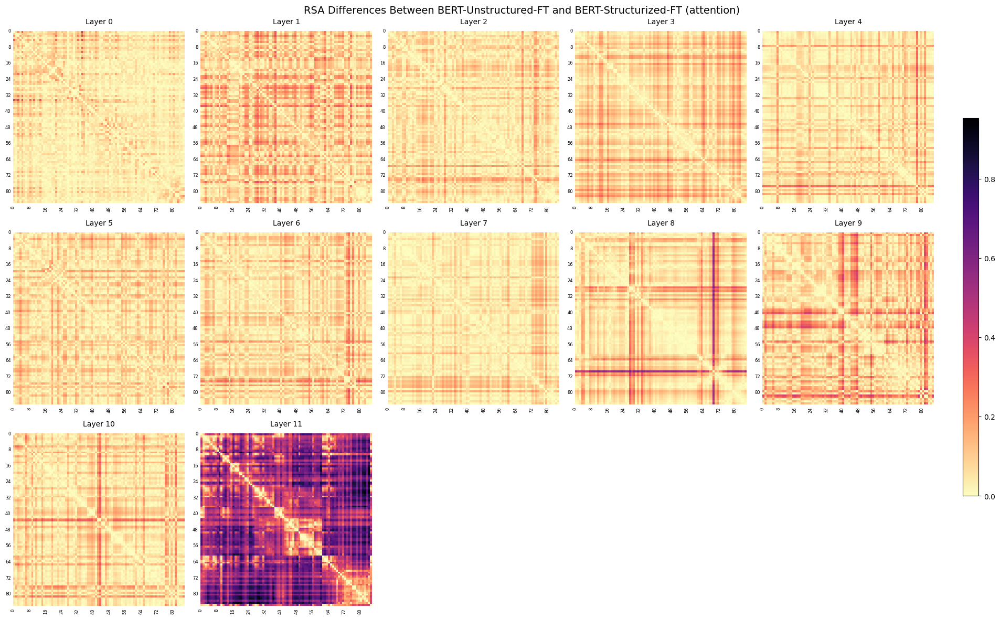

In [85]:
comparator3.plot_rsa(question, context, method="correlation", representation_type = "attention")

### on Hidden States

#### CS

In [86]:
comparator1.compare_cosine_similarity(question, context, "hidden_states")

{0: 0.9958662390708923,
 1: 0.9725542068481445,
 2: 0.965779185295105,
 3: 0.9569659233093262,
 4: 0.9505231976509094,
 5: 0.9424444437026978,
 6: 0.9285904765129089,
 7: 0.9027285575866699,
 8: 0.8737314343452454,
 9: 0.8433007597923279,
 10: 0.7970672845840454,
 11: 0.7268555164337158,
 12: 0.3144398331642151}

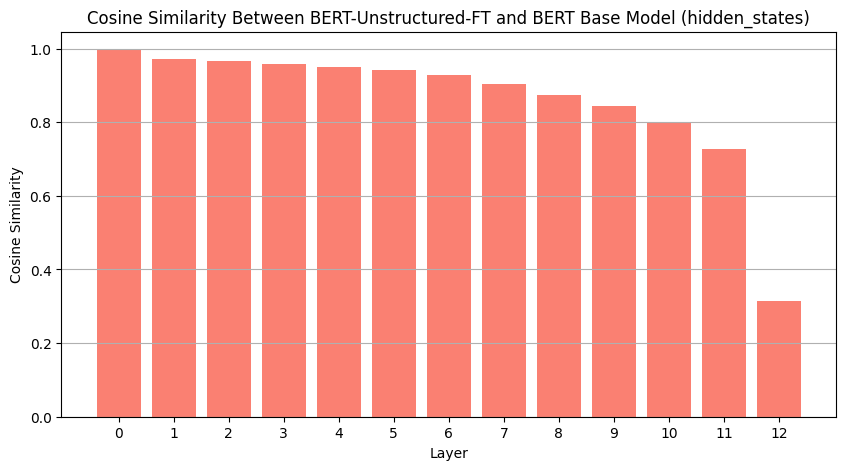

In [87]:
comparator1.plot_cosine_similarity(question, context, "hidden_states")

In [88]:
comparator2.compare_cosine_similarity(question, context, "hidden_states")

{0: 0.9956596493721008,
 1: 0.9770361185073853,
 2: 0.9688986539840698,
 3: 0.9602543115615845,
 4: 0.952750563621521,
 5: 0.9434947967529297,
 6: 0.9302946329116821,
 7: 0.906638503074646,
 8: 0.8803051710128784,
 9: 0.8483119606971741,
 10: 0.8022726774215698,
 11: 0.7557392120361328,
 12: 0.3838611841201782}

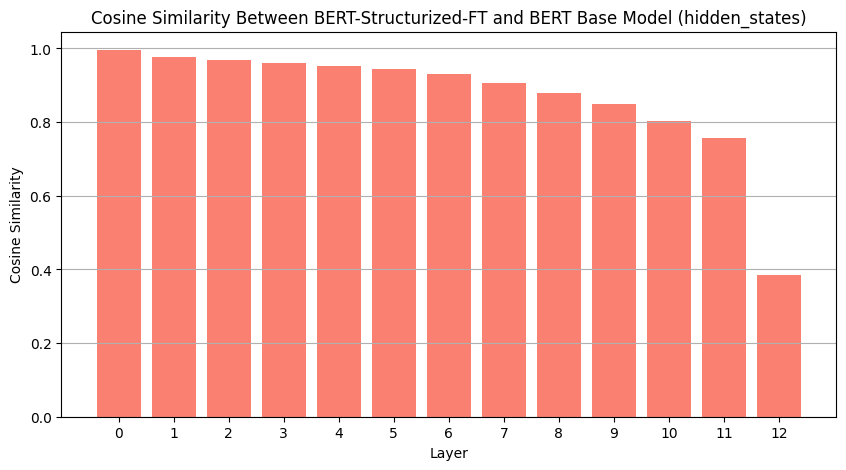

In [89]:
comparator2.plot_cosine_similarity(question, context, "hidden_states")

In [90]:
comparator3.compare_cosine_similarity(question, context, "hidden_states")

{0: 0.9930180311203003,
 1: 0.9760934114456177,
 2: 0.9616461992263794,
 3: 0.9506636261940002,
 4: 0.945685863494873,
 5: 0.9416334629058838,
 6: 0.934545636177063,
 7: 0.9216726422309875,
 8: 0.909923255443573,
 9: 0.8999139070510864,
 10: 0.8752314448356628,
 11: 0.8356452584266663,
 12: 0.7244199514389038}

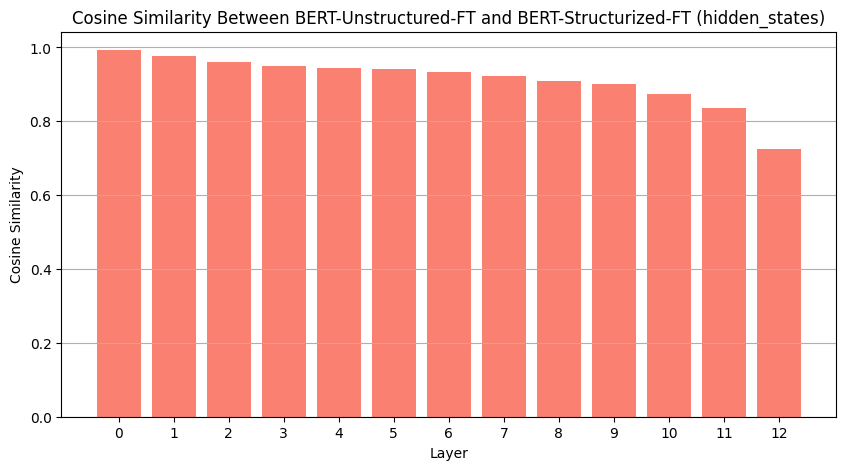

In [91]:
comparator3.plot_cosine_similarity(question, context, "hidden_states")

#### RSA

In [92]:
comparator1.compare_rsa(question, context, method="correlation", representation_type = "hidden_states")

{0: array([[0.        , 0.00738255, 0.00794886, ..., 0.0020215 , 0.01268412,
         0.00613921],
        [0.00738255, 0.        , 0.00311171, ..., 0.00736864, 0.00409954,
         0.00572295],
        [0.00794886, 0.00311171, 0.        , ..., 0.00712881, 0.00291128,
         0.00552638],
        ...,
        [0.0020215 , 0.00736864, 0.00712881, ..., 0.        , 0.00859542,
         0.00812086],
        [0.01268412, 0.00409954, 0.00291128, ..., 0.00859542, 0.        ,
         0.0041116 ],
        [0.00613921, 0.00572295, 0.00552638, ..., 0.00812086, 0.0041116 ,
         0.        ]]),
 1: array([[0.00000000e+00, 1.91283711e-02, 7.85727777e-05, ...,
         2.62865446e-03, 5.82804895e-02, 5.82071879e-02],
        [1.91283711e-02, 0.00000000e+00, 2.66535244e-02, ...,
         1.11925014e-02, 9.21043603e-03, 2.78083317e-03],
        [7.85727777e-05, 2.66535244e-02, 0.00000000e+00, ...,
         8.86095552e-03, 2.63213474e-02, 1.05370169e-02],
        ...,
        [2.62865446e-03, 1.119

C:\Users\proxi\AppData\Local\Temp\ipykernel_44408\88738578.py:175: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])


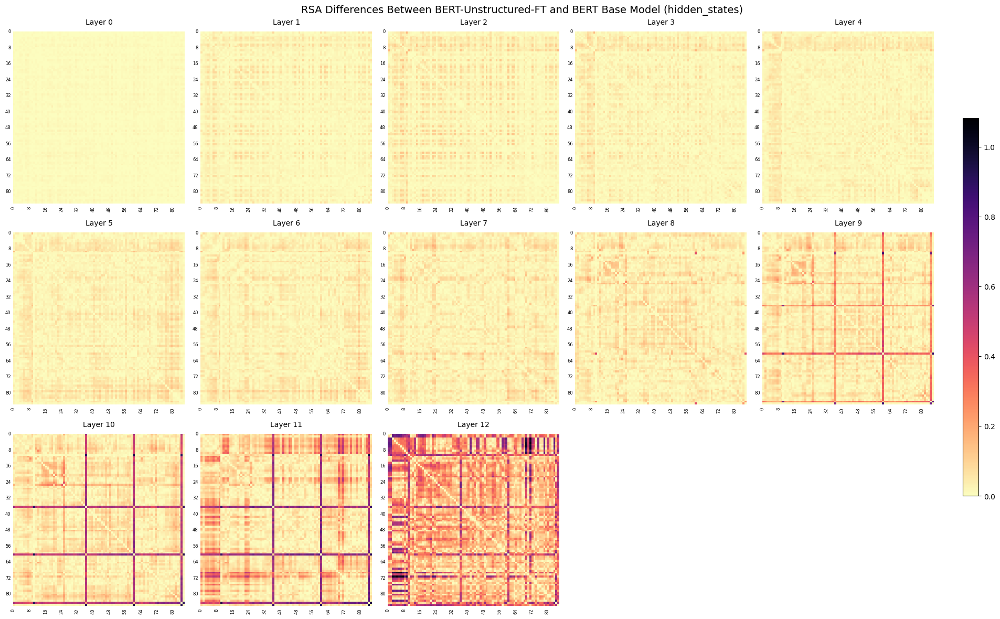

In [93]:
comparator1.plot_rsa(question, context, method="correlation", representation_type = "hidden_states")

In [94]:
comparator2.compare_rsa(question, context, method="correlation", representation_type = "hidden_states")

{0: array([[0.        , 0.00171561, 0.00058267, ..., 0.00503513, 0.01399758,
         0.00051586],
        [0.00171561, 0.        , 0.00106258, ..., 0.00277018, 0.00189563,
         0.00188286],
        [0.00058267, 0.00106258, 0.        , ..., 0.00346433, 0.00451167,
         0.00035595],
        ...,
        [0.00503513, 0.00277018, 0.00346433, ..., 0.        , 0.00489388,
         0.00593869],
        [0.01399758, 0.00189563, 0.00451167, ..., 0.00489388, 0.        ,
         0.00854323],
        [0.00051586, 0.00188286, 0.00035595, ..., 0.00593869, 0.00854323,
         0.        ]]),
 1: array([[0.        , 0.03731667, 0.01236982, ..., 0.02532977, 0.06222998,
         0.03902505],
        [0.03731667, 0.        , 0.0202125 , ..., 0.00475726, 0.03570942,
         0.02952497],
        [0.01236982, 0.0202125 , 0.        , ..., 0.00124823, 0.01097694,
         0.00268844],
        ...,
        [0.02532977, 0.00475726, 0.00124823, ..., 0.        , 0.01998606,
         0.00886502],
      

C:\Users\proxi\AppData\Local\Temp\ipykernel_44408\88738578.py:175: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])


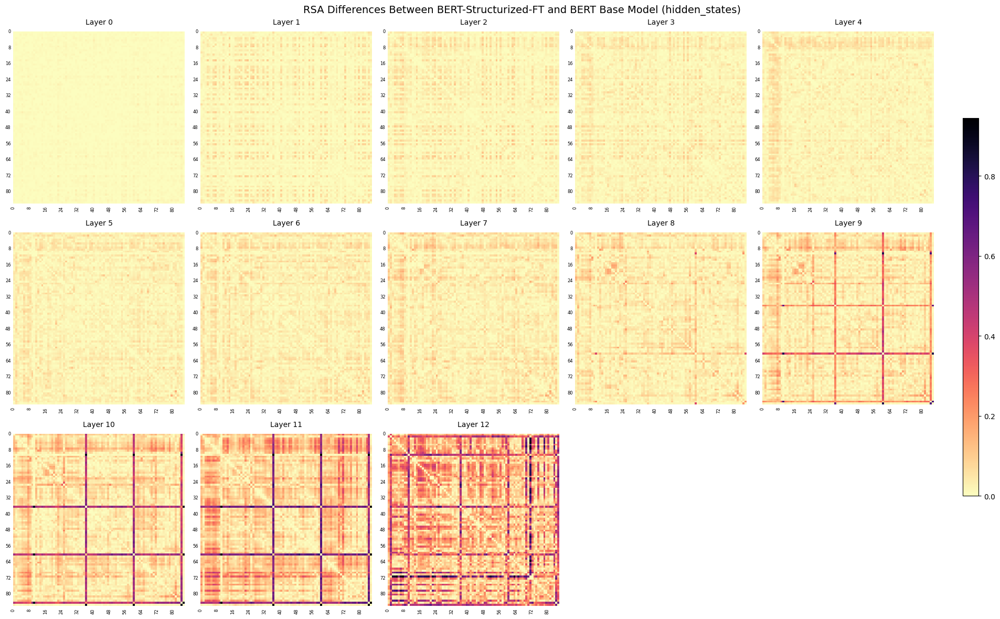

In [95]:
comparator2.plot_rsa(question, context, method="correlation", representation_type = "hidden_states")

In [96]:
comparator3.compare_rsa(question, context, method="correlation", representation_type = "hidden_states")

{0: array([[0.        , 0.00566694, 0.0073662 , ..., 0.00301363, 0.00131347,
         0.00562335],
        [0.00566694, 0.        , 0.00204913, ..., 0.01013882, 0.00599516,
         0.0076058 ],
        [0.0073662 , 0.00204913, 0.        , ..., 0.01059314, 0.00160039,
         0.00517043],
        ...,
        [0.00301363, 0.01013882, 0.01059314, ..., 0.        , 0.0134893 ,
         0.00218217],
        [0.00131347, 0.00599516, 0.00160039, ..., 0.0134893 , 0.        ,
         0.00443162],
        [0.00562335, 0.0076058 , 0.00517043, ..., 0.00218217, 0.00443162,
         0.        ]]),
 1: array([[0.        , 0.0181883 , 0.01244839, ..., 0.02270112, 0.00394949,
         0.01918213],
        [0.0181883 , 0.        , 0.00644103, ..., 0.00643524, 0.02649898,
         0.03230581],
        [0.01244839, 0.00644103, 0.        , ..., 0.01010919, 0.0153444 ,
         0.00784857],
        ...,
        [0.02270112, 0.00643524, 0.01010919, ..., 0.        , 0.01678395,
         0.00459299],
      

C:\Users\proxi\AppData\Local\Temp\ipykernel_44408\88738578.py:175: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])


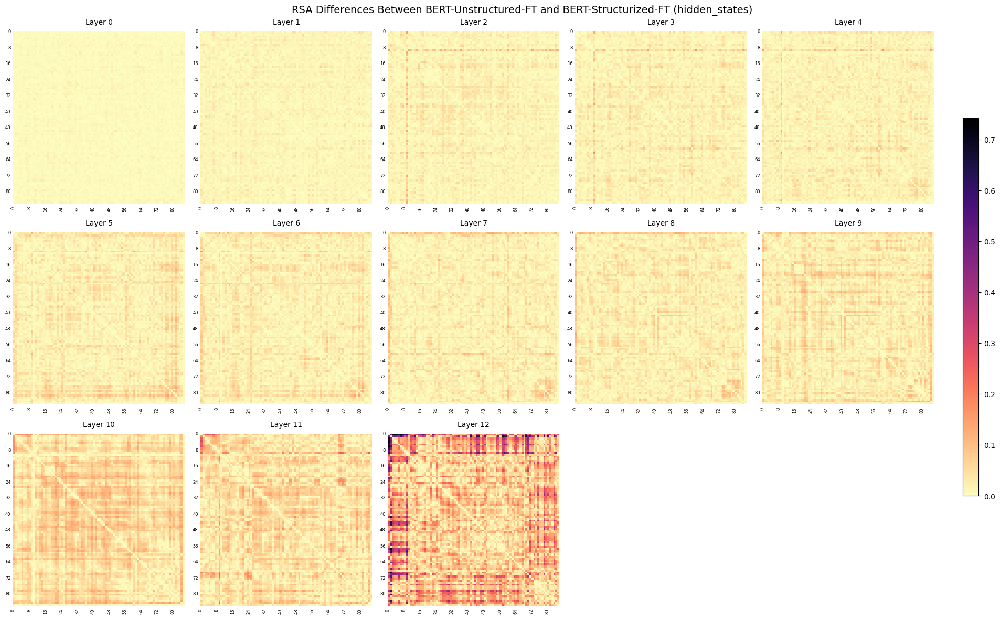

In [97]:
comparator3.plot_rsa(question, context, method="correlation", representation_type = "hidden_states")

## Structurized Input Format

### on Attention Scores

#### JSD

In [98]:
comparator1.compare_layerwise_jsd(question, structurized_context, "attention")

{0: 0.05662412595866609,
 1: 0.11170273549929231,
 2: 0.13441214131827792,
 3: 0.11266916426762237,
 4: 0.13947115142059088,
 5: 0.13261661562421814,
 6: 0.14614593454305172,
 7: 0.17519336850949221,
 8: 0.23238904237169689,
 9: 0.24933812693878776,
 10: 0.23914159857696682,
 11: 0.4923825997888626}

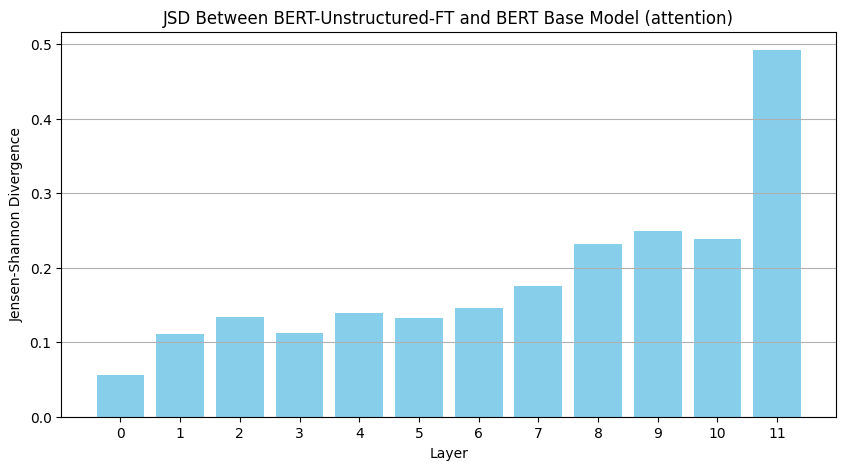

In [99]:
comparator1.plot_jsd(question, structurized_context, "attention")

In [100]:
comparator2.compare_layerwise_jsd(question, structurized_context, "attention")

{0: 0.06932784561259912,
 1: 0.12666841371324808,
 2: 0.13610109376533477,
 3: 0.1387174318543736,
 4: 0.15925806136111398,
 5: 0.1645734665251778,
 6: 0.15870801408891852,
 7: 0.16978740705239945,
 8: 0.20507609337876076,
 9: 0.22913634953995596,
 10: 0.27192505616094176,
 11: 0.31904862856463295}

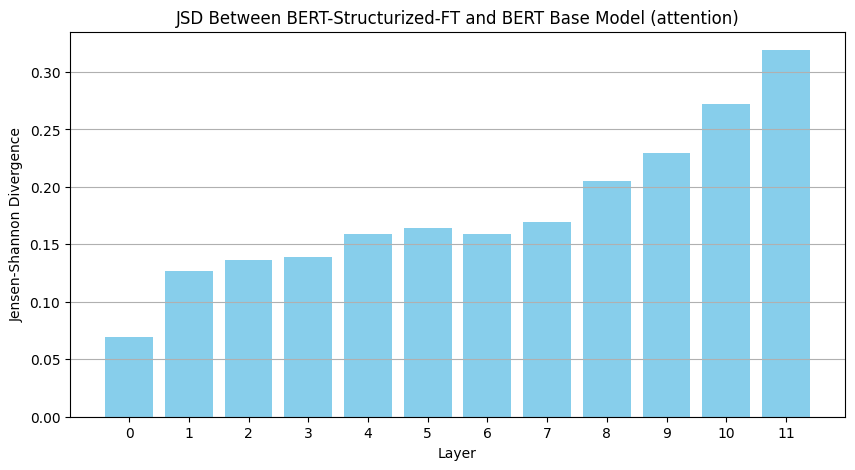

In [101]:
comparator2.plot_jsd(question, structurized_context, "attention")

In [102]:
comparator3.compare_layerwise_jsd(question, structurized_context, "attention")

{0: 0.07753133395282519,
 1: 0.1291799808727027,
 2: 0.12676511508867272,
 3: 0.1400179777638176,
 4: 0.15376414770088628,
 5: 0.16430573790912725,
 6: 0.17582053646730486,
 7: 0.1986992874856048,
 8: 0.231258458184516,
 9: 0.23833267537634942,
 10: 0.21820887294714925,
 11: 0.3347677757571468}

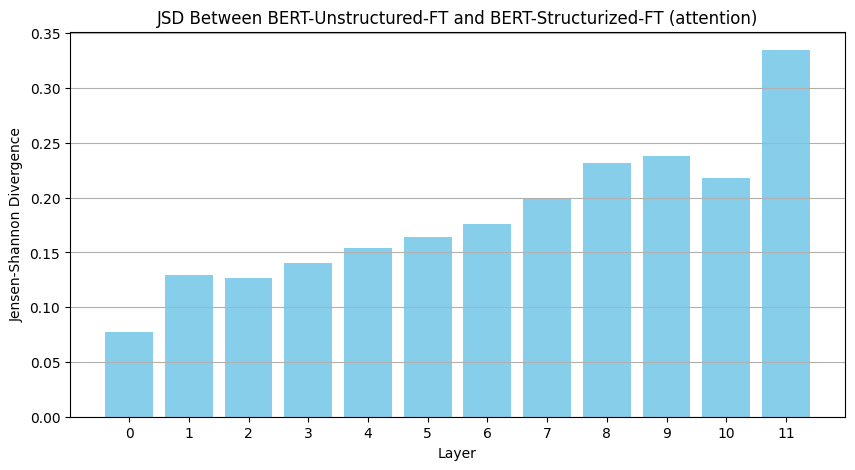

In [103]:
comparator3.plot_jsd(question, structurized_context, "attention")

#### RSA

In [104]:
comparator1.compare_rsa(question, structurized_context, method="correlation", representation_type = "attention")

{0: array([[0.        , 0.11788847, 0.40330774, ..., 0.04503296, 0.01736364,
         0.03363311],
        [0.11788847, 0.        , 0.10079361, ..., 0.01256702, 0.04279039,
         0.05487037],
        [0.40330774, 0.10079361, 0.        , ..., 0.01265358, 0.07012599,
         0.12870972],
        ...,
        [0.04503296, 0.01256702, 0.01265358, ..., 0.        , 0.04149452,
         0.02315416],
        [0.01736364, 0.04279039, 0.07012599, ..., 0.04149452, 0.        ,
         0.00318281],
        [0.03363311, 0.05487037, 0.12870972, ..., 0.02315416, 0.00318281,
         0.        ]]),
 1: array([[0.        , 0.01171541, 0.13545144, ..., 0.09299623, 0.09435734,
         0.01110522],
        [0.01171541, 0.        , 0.11013351, ..., 0.06982417, 0.09602854,
         0.01677321],
        [0.13545144, 0.11013351, 0.        , ..., 0.01361603, 0.00255863,
         0.15116399],
        ...,
        [0.09299623, 0.06982417, 0.01361603, ..., 0.        , 0.07090065,
         0.06689883],
      

C:\Users\proxi\AppData\Local\Temp\ipykernel_44408\88738578.py:175: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])


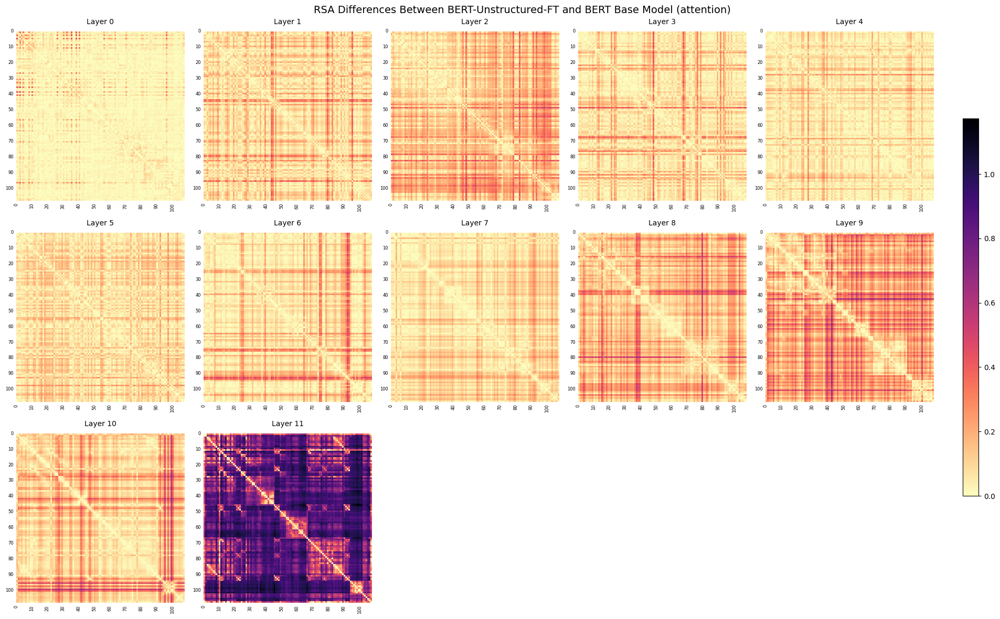

In [105]:
comparator1.plot_rsa(question, structurized_context, method="correlation", representation_type = "attention")

In [106]:
comparator2.compare_rsa(question, structurized_context, method="correlation", representation_type = "attention")

{0: array([[0.        , 0.01166766, 0.17066854, ..., 0.02220289, 0.0035342 ,
         0.00625388],
        [0.01166766, 0.        , 0.10654999, ..., 0.01159529, 0.05265458,
         0.03906818],
        [0.17066854, 0.10654999, 0.        , ..., 0.00483367, 0.01317262,
         0.06526407],
        ...,
        [0.02220289, 0.01159529, 0.00483367, ..., 0.        , 0.13835626,
         0.16815822],
        [0.0035342 , 0.05265458, 0.01317262, ..., 0.13835626, 0.        ,
         0.07186777],
        [0.00625388, 0.03906818, 0.06526407, ..., 0.16815822, 0.07186777,
         0.        ]]),
 1: array([[0.        , 0.01786229, 0.09981858, ..., 0.05112424, 0.04522001,
         0.00500204],
        [0.01786229, 0.        , 0.07235078, ..., 0.04787932, 0.03392392,
         0.0160122 ],
        [0.09981858, 0.07235078, 0.        , ..., 0.07402632, 0.03682597,
         0.09165465],
        ...,
        [0.05112424, 0.04787932, 0.07402632, ..., 0.        , 0.03874212,
         0.05641751],
      

C:\Users\proxi\AppData\Local\Temp\ipykernel_44408\88738578.py:175: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])


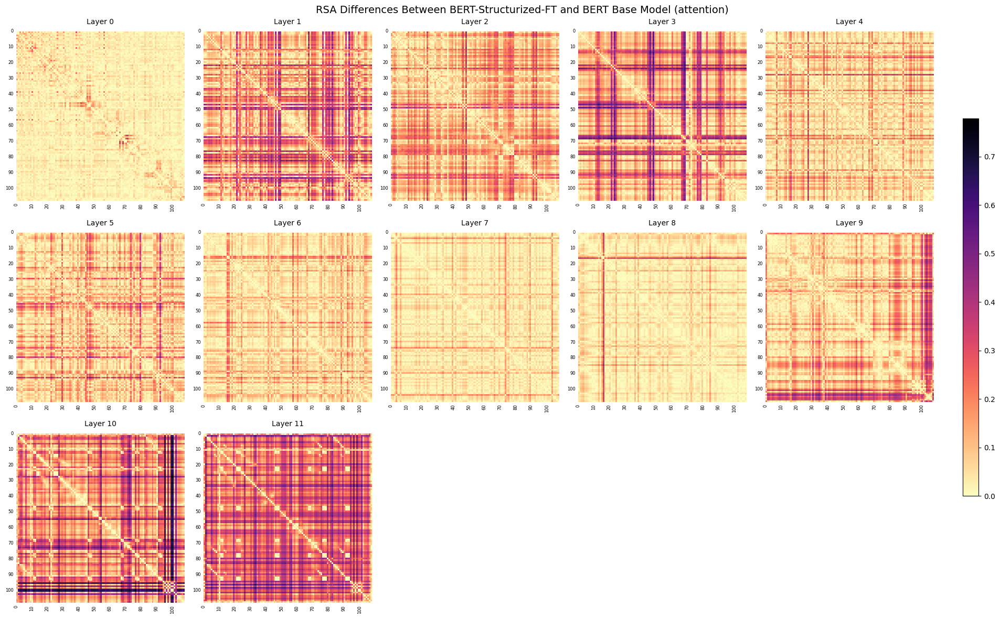

In [107]:
comparator2.plot_rsa(question, structurized_context, method="correlation", representation_type = "attention")

In [108]:
comparator3.compare_rsa(question, structurized_context, method="correlation", representation_type = "attention")

{0: array([[0.        , 0.10622081, 0.2326392 , ..., 0.06723586, 0.01382944,
         0.02737924],
        [0.10622081, 0.        , 0.00575637, ..., 0.00097173, 0.00986419,
         0.01580219],
        [0.2326392 , 0.00575637, 0.        , ..., 0.01748725, 0.05695337,
         0.06344565],
        ...,
        [0.06723586, 0.00097173, 0.01748725, ..., 0.        , 0.09686175,
         0.19131238],
        [0.01382944, 0.00986419, 0.05695337, ..., 0.09686175, 0.        ,
         0.06868496],
        [0.02737924, 0.01580219, 0.06344565, ..., 0.19131238, 0.06868496,
         0.        ]]),
 1: array([[0.        , 0.0295777 , 0.23527002, ..., 0.04187199, 0.13957735,
         0.00610318],
        [0.0295777 , 0.        , 0.1824843 , ..., 0.02194485, 0.12995246,
         0.0327854 ],
        [0.23527002, 0.1824843 , 0.        , ..., 0.08764235, 0.03426734,
         0.24281864],
        ...,
        [0.04187199, 0.02194485, 0.08764235, ..., 0.        , 0.03215853,
         0.01048132],
      

C:\Users\proxi\AppData\Local\Temp\ipykernel_44408\88738578.py:175: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])


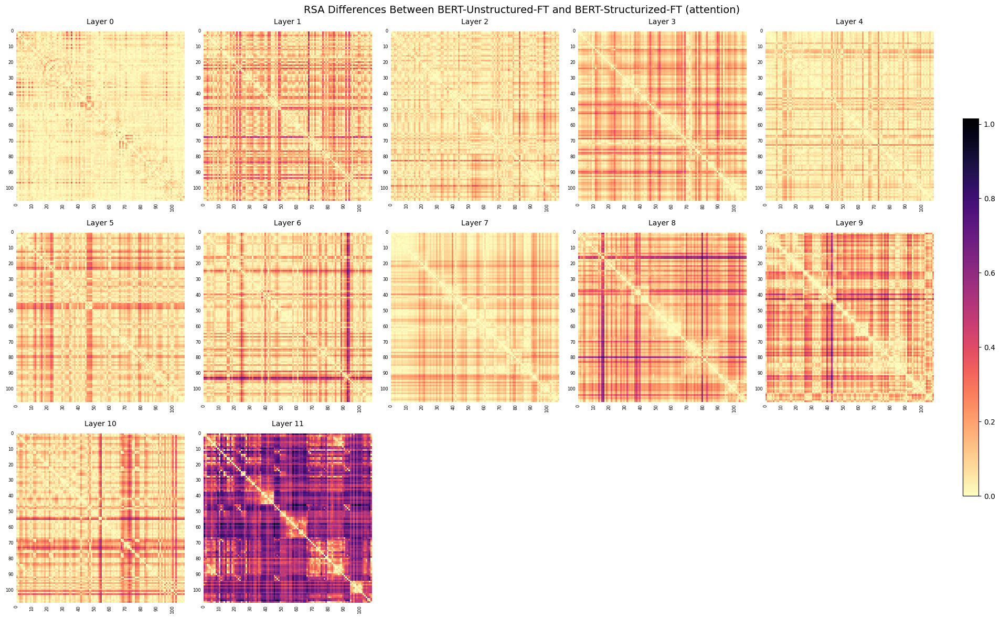

In [109]:
comparator3.plot_rsa(question, structurized_context, method="correlation", representation_type = "attention")

### on Hidden States

#### CS

In [110]:
comparator1.compare_cosine_similarity(question, structurized_context, "hidden_states")

{0: 0.9960746765136719,
 1: 0.9760597348213196,
 2: 0.9667218327522278,
 3: 0.9557706713676453,
 4: 0.9468056559562683,
 5: 0.9338403940200806,
 6: 0.9120387434959412,
 7: 0.8821632862091064,
 8: 0.847885251045227,
 9: 0.8213995099067688,
 10: 0.7688882946968079,
 11: 0.6762272119522095,
 12: 0.27726686000823975}

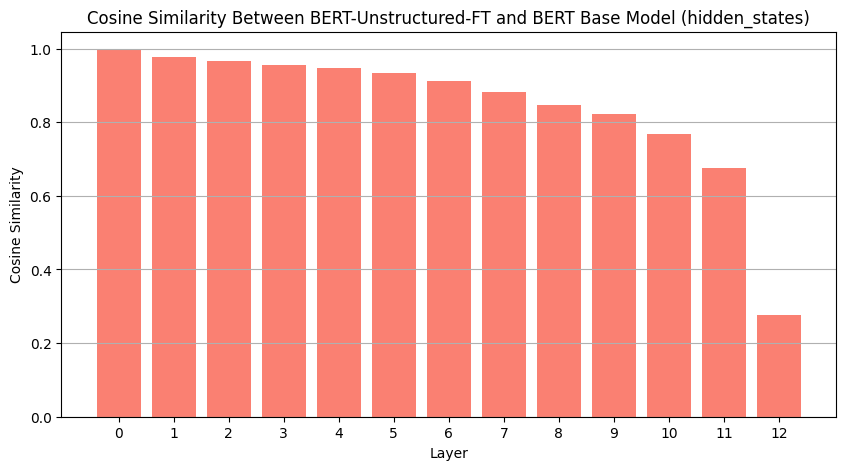

In [111]:
comparator1.plot_cosine_similarity(question, structurized_context, "hidden_states")

In [112]:
comparator2.compare_cosine_similarity(question, structurized_context, "hidden_states")

{0: 0.9958238005638123,
 1: 0.9751829504966736,
 2: 0.9590093493461609,
 3: 0.941747784614563,
 4: 0.9269970655441284,
 5: 0.9102943539619446,
 6: 0.8900755643844604,
 7: 0.8614188432693481,
 8: 0.8332719802856445,
 9: 0.8108210563659668,
 10: 0.7672315239906311,
 11: 0.6787785291671753,
 12: 0.2825281620025635}

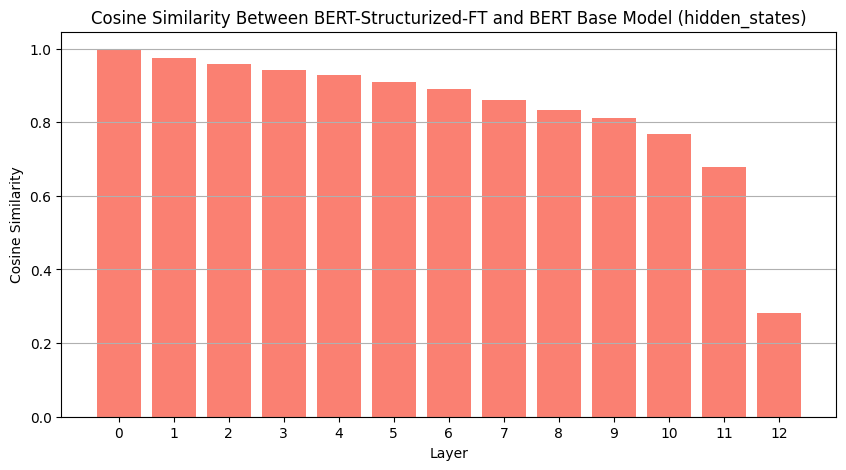

In [113]:
comparator2.plot_cosine_similarity(question, structurized_context, "hidden_states")

In [114]:
comparator3.compare_cosine_similarity(question, structurized_context, "hidden_states")

{0: 0.9932262301445007,
 1: 0.9755070209503174,
 2: 0.9525554180145264,
 3: 0.9333425164222717,
 4: 0.9229652881622314,
 5: 0.9117520451545715,
 6: 0.8946724534034729,
 7: 0.8752475380897522,
 8: 0.8570313453674316,
 9: 0.8427411913871765,
 10: 0.808928370475769,
 11: 0.7638809680938721,
 12: 0.6840865612030029}

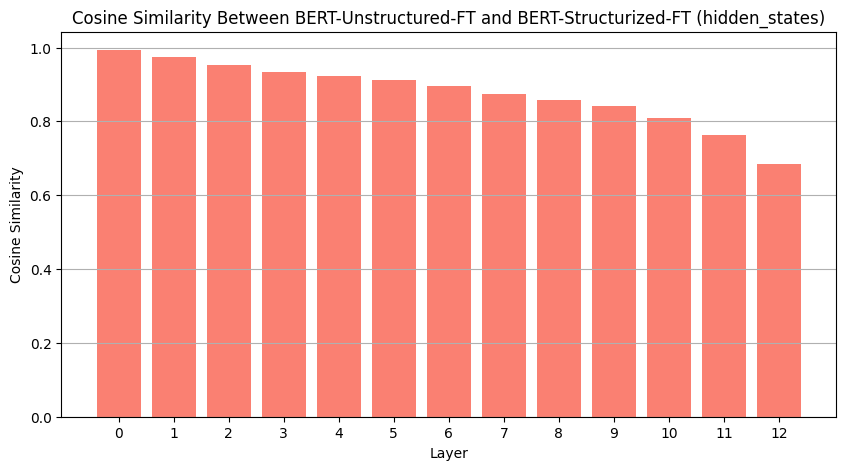

In [115]:
comparator3.plot_cosine_similarity(question, structurized_context, "hidden_states")

#### RSA

In [116]:
comparator1.compare_rsa(question, structurized_context, method="correlation", representation_type = "hidden_states")

{0: array([[0.        , 0.00738255, 0.00794886, ..., 0.00177008, 0.00729095,
         0.009212  ],
        [0.00738255, 0.        , 0.00311171, ..., 0.0060853 , 0.00873702,
         0.00360566],
        [0.00794886, 0.00311171, 0.        , ..., 0.00302453, 0.00539722,
         0.00066778],
        ...,
        [0.00177008, 0.0060853 , 0.00302453, ..., 0.        , 0.00303872,
         0.01335796],
        [0.00729095, 0.00873702, 0.00539722, ..., 0.00303872, 0.        ,
         0.01126149],
        [0.009212  , 0.00360566, 0.00066778, ..., 0.01335796, 0.01126149,
         0.        ]]),
 1: array([[0.        , 0.02064681, 0.00383803, ..., 0.01724082, 0.057128  ,
         0.0687105 ],
        [0.02064681, 0.        , 0.02957143, ..., 0.01375305, 0.01298396,
         0.00963243],
        [0.00383803, 0.02957143, 0.        , ..., 0.02769893, 0.02662524,
         0.0113765 ],
        ...,
        [0.01724082, 0.01375305, 0.02769893, ..., 0.        , 0.01561863,
         0.02508577],
      

C:\Users\proxi\AppData\Local\Temp\ipykernel_44408\88738578.py:175: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])


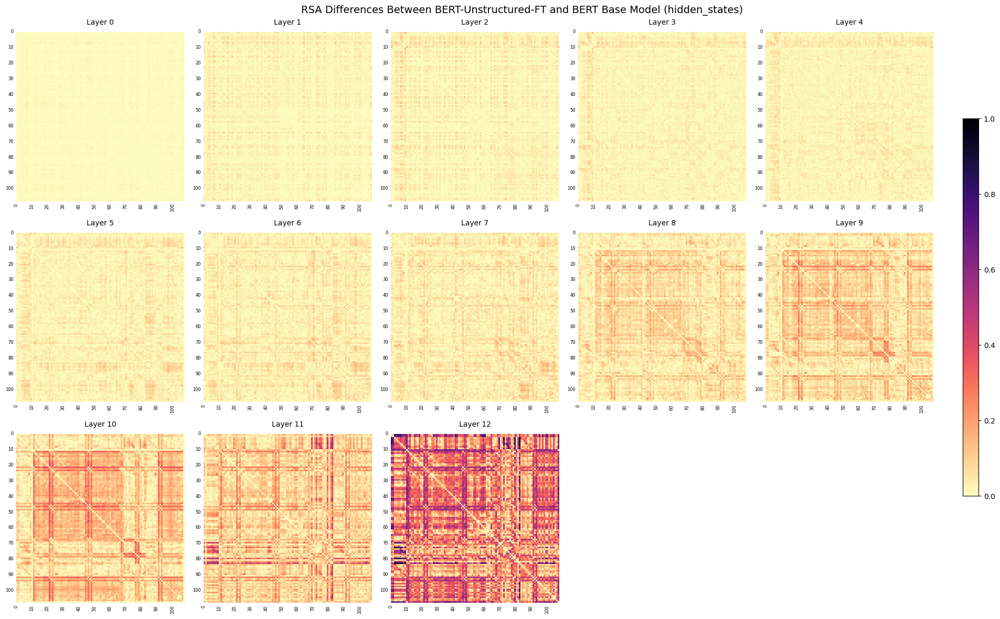

In [117]:
comparator1.plot_rsa(question, structurized_context, method="correlation", representation_type = "hidden_states")

In [118]:
comparator2.compare_rsa(question, structurized_context, method="correlation", representation_type = "hidden_states")

{0: array([[0.        , 0.00171561, 0.00058267, ..., 0.00062853, 0.01789443,
         0.00391211],
        [0.00171561, 0.        , 0.00106258, ..., 0.00261803, 0.00317717,
         0.00336599],
        [0.00058267, 0.00106258, 0.        , ..., 0.00789382, 0.00518882,
         0.00314587],
        ...,
        [0.00062853, 0.00261803, 0.00789382, ..., 0.        , 0.00267435,
         0.0018213 ],
        [0.01789443, 0.00317717, 0.00518882, ..., 0.00267435, 0.        ,
         0.00225166],
        [0.00391211, 0.00336599, 0.00314587, ..., 0.0018213 , 0.00225166,
         0.        ]]),
 1: array([[0.        , 0.03947508, 0.00963549, ..., 0.00638015, 0.07509868,
         0.04017272],
        [0.03947508, 0.        , 0.02533687, ..., 0.00616045, 0.03953683,
         0.04065284],
        [0.00963549, 0.02533687, 0.        , ..., 0.0085092 , 0.00016632,
         0.00263509],
        ...,
        [0.00638015, 0.00616045, 0.0085092 , ..., 0.        , 0.00340433,
         0.01190271],
      

C:\Users\proxi\AppData\Local\Temp\ipykernel_44408\88738578.py:175: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])


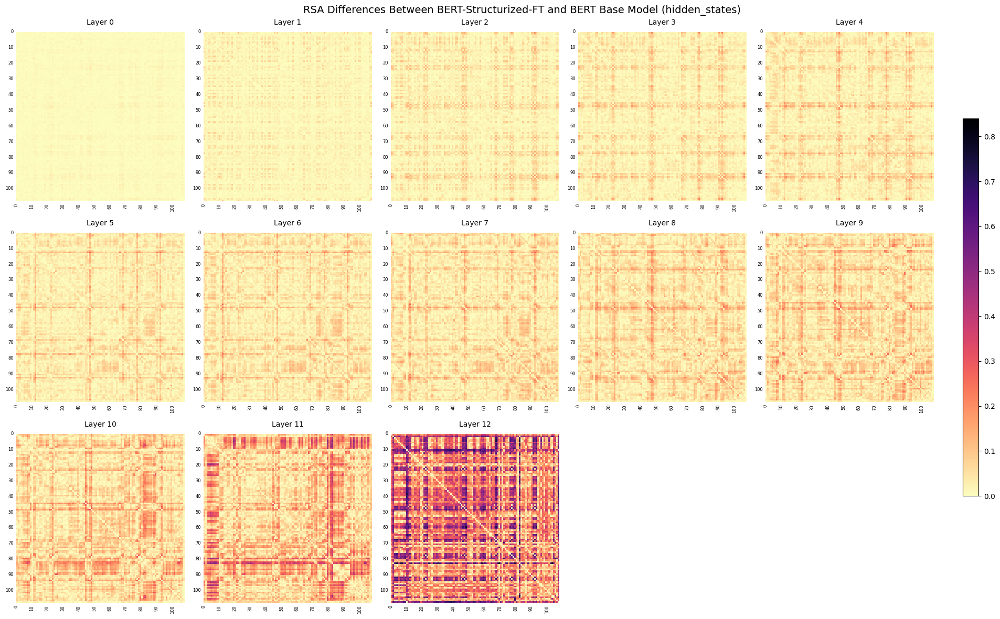

In [119]:
comparator2.plot_rsa(question, structurized_context, method="correlation", representation_type = "hidden_states")

In [120]:
comparator3.compare_rsa(question, structurized_context, method="correlation", representation_type = "hidden_states")

{0: array([[0.        , 0.00566694, 0.0073662 , ..., 0.00239861, 0.01060348,
         0.00529989],
        [0.00566694, 0.        , 0.00204913, ..., 0.00346727, 0.01191419,
         0.00697166],
        [0.0073662 , 0.00204913, 0.        , ..., 0.01091834, 0.01058604,
         0.00247809],
        ...,
        [0.00239861, 0.00346727, 0.01091834, ..., 0.        , 0.00571307,
         0.01517926],
        [0.01060348, 0.01191419, 0.01058604, ..., 0.00571307, 0.        ,
         0.00900983],
        [0.00529989, 0.00697166, 0.00247809, ..., 0.01517926, 0.00900983,
         0.        ]]),
 1: array([[0.        , 0.01882828, 0.01347353, ..., 0.01086067, 0.01797068,
         0.02853779],
        [0.01882828, 0.        , 0.00423456, ..., 0.0075926 , 0.02655287,
         0.03102042],
        [0.01347353, 0.00423456, 0.        , ..., 0.01918974, 0.02645892,
         0.01401159],
        ...,
        [0.01086067, 0.0075926 , 0.01918974, ..., 0.        , 0.0122143 ,
         0.01318307],
      

C:\Users\proxi\AppData\Local\Temp\ipykernel_44408\88738578.py:175: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])


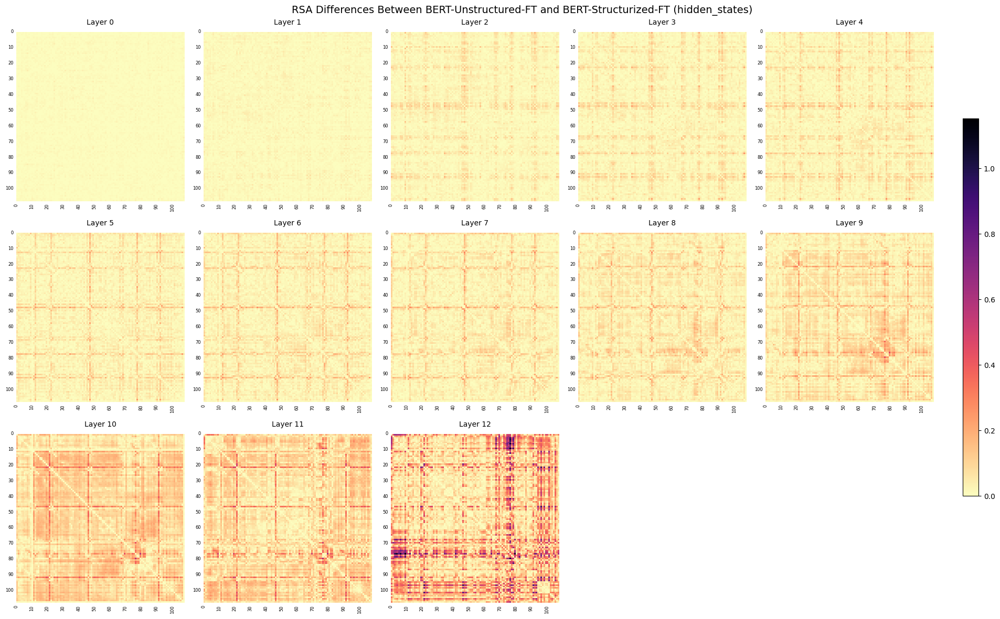

In [121]:
comparator3.plot_rsa(question, structurized_context, method="correlation", representation_type = "hidden_states")

# EXPERIMENT 2: COMPARE EACH MODEL WITH DIFFERENT INPUT FORMATS

Due to the different sizes in input sequences (unstructured context length != structurized context length), instead of RSA and JSD, which assumes the equal lengths for pairwise computations, Wasserstein's (Earth's Mover) Distance is utilized in this experiment.

In [122]:
input_comparator = QAInputComparator(question, context, structurized_context)

## Base Model

### on Attention Scores

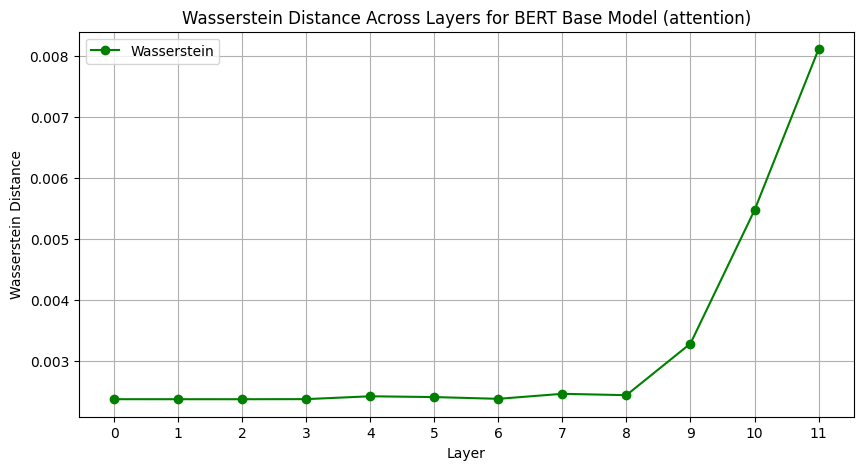

In [123]:
input_comparator.plot_wasserstein(qa_analyzer_base, "attention")

In [124]:
# input_comparator.plot_contexts_jsd(qa_analyzer_base, "attention")

In [125]:
# input_comparator.plot_contexts_rsa(qa_analyzer_base, method='correlation', representation_type='attention')

### on Hidden States

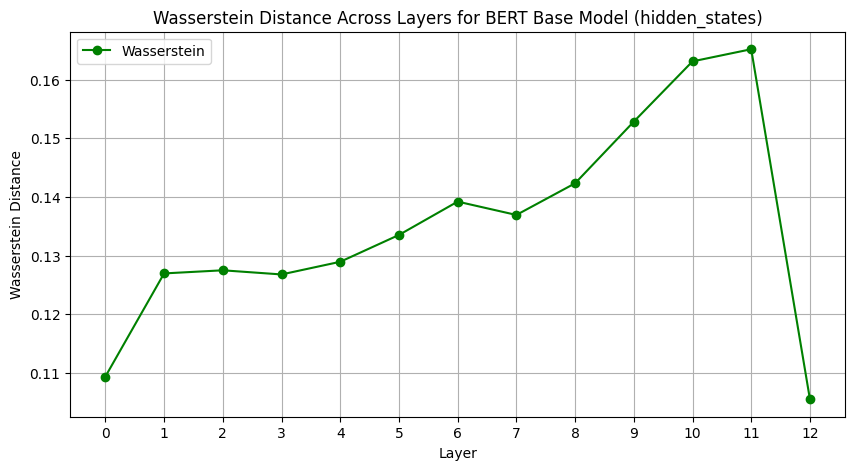

In [126]:
input_comparator.plot_wasserstein(qa_analyzer_base)

In [127]:
# input_comparator.plot_contexts_jsd(qa_analyzer_base)

In [128]:
# input_comparator.plot_contexts_rsa(qa_analyzer_base, method='correlation')

## Unstructured-FT Model

### on Attention Scores

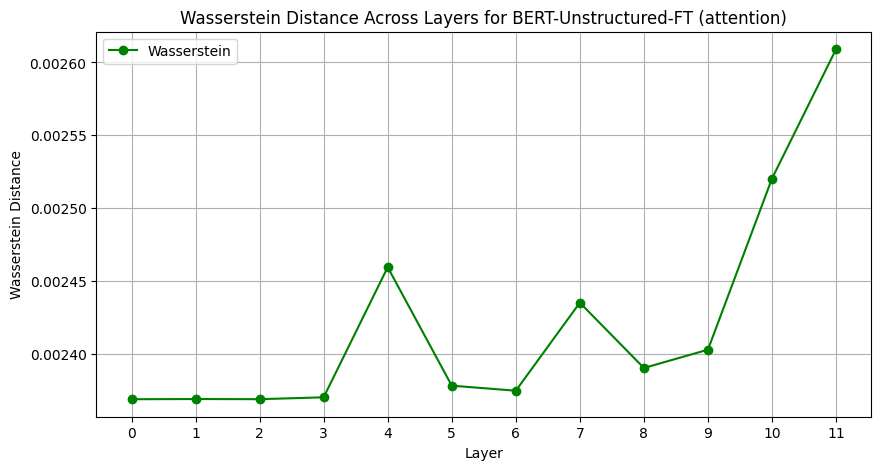

In [129]:
input_comparator.plot_wasserstein(qa_analyzer_unstructured, "attention")

In [130]:
# input_comparator.plot_contexts_jsd(qa_analyzer_unstructured, "attention")

In [131]:
# input_comparator.plot_contexts_rsa(qa_analyzer_unstructured, method='correlation', representation_type='attention')

### on Hidden States

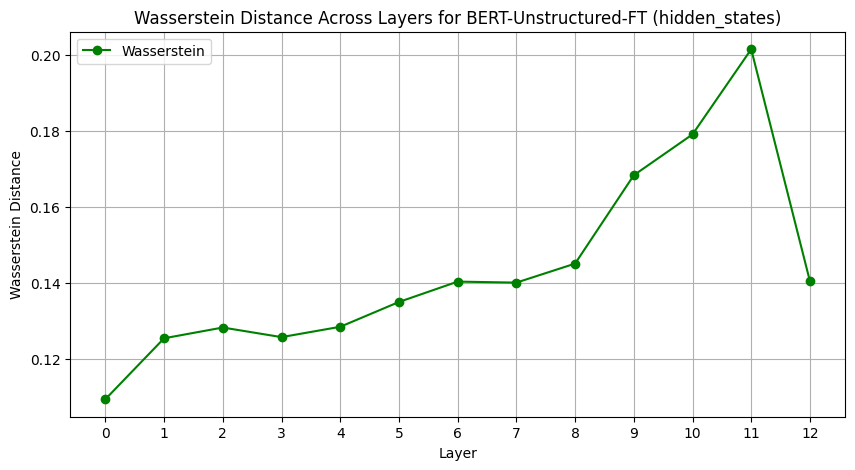

In [132]:
input_comparator.plot_wasserstein(qa_analyzer_unstructured)

In [133]:
# input_comparator.plot_contexts_jsd(qa_analyzer_unstructured)

In [134]:
# input_comparator.plot_contexts_rsa(qa_analyzer_unstructured, method='correlation')

## Structurized-FT Model

### on Attention Scores

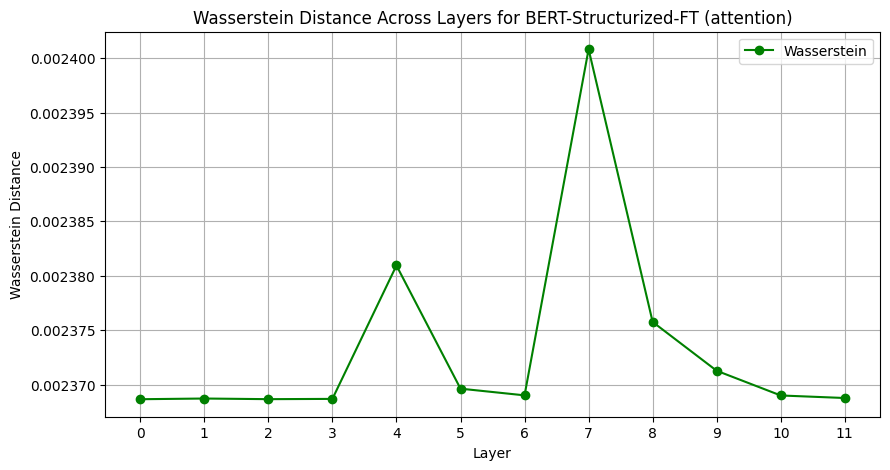

In [135]:
input_comparator.plot_wasserstein(qa_analyzer_structurized, "attention")

In [136]:
# input_comparator.plot_contexts_jsd(qa_analyzer_structurized, "attention")

In [137]:
# input_comparator.plot_contexts_rsa(qa_analyzer_structurized, method='correlation', representation_type='attention')

### on Hidden States

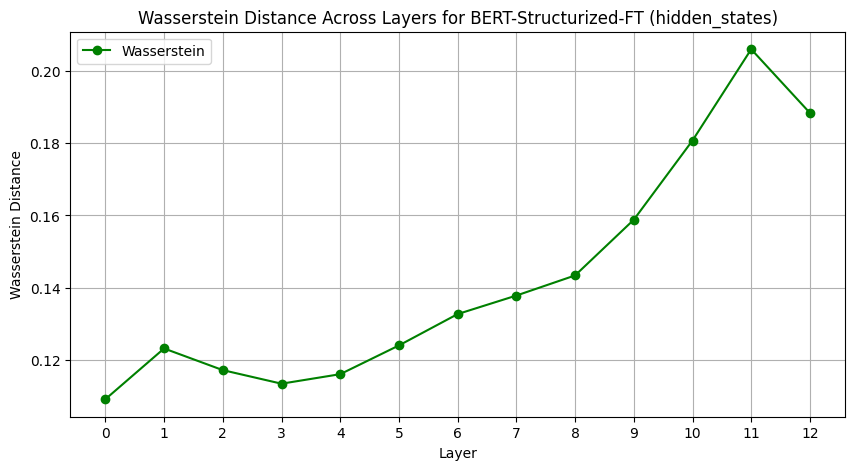

In [138]:
input_comparator.plot_wasserstein(qa_analyzer_structurized)

In [139]:
# input_comparator.plot_contexts_jsd(qa_analyzer_structurized)

In [140]:
# input_comparator.plot_contexts_rsa(qa_analyzer_structurized, method='correlation')

# Multi-Line Plots

## Model Comparison

In [141]:
multimodel_model_comparator = MultiModelComparator([comparator1, comparator2, comparator3])

### Unstructured Input

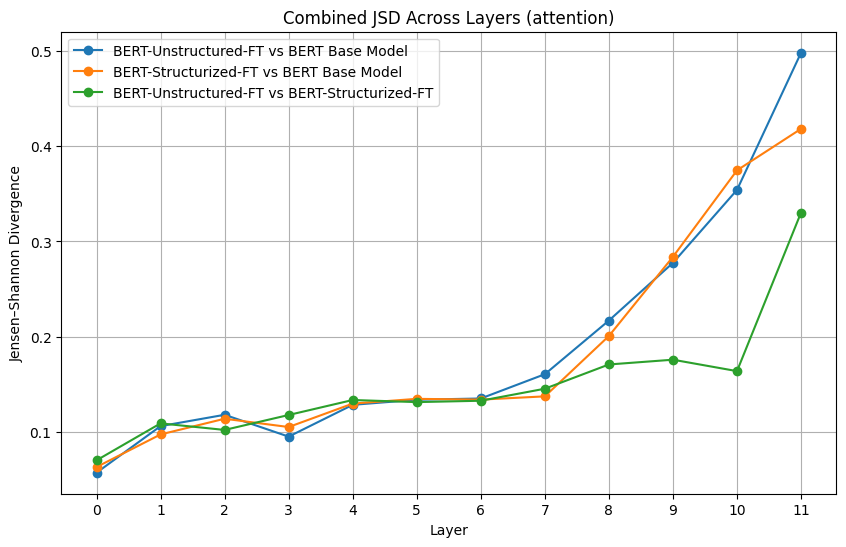

In [142]:
multimodel_model_comparator.multi_plot_jsd(question, context, representation_type = "attention")

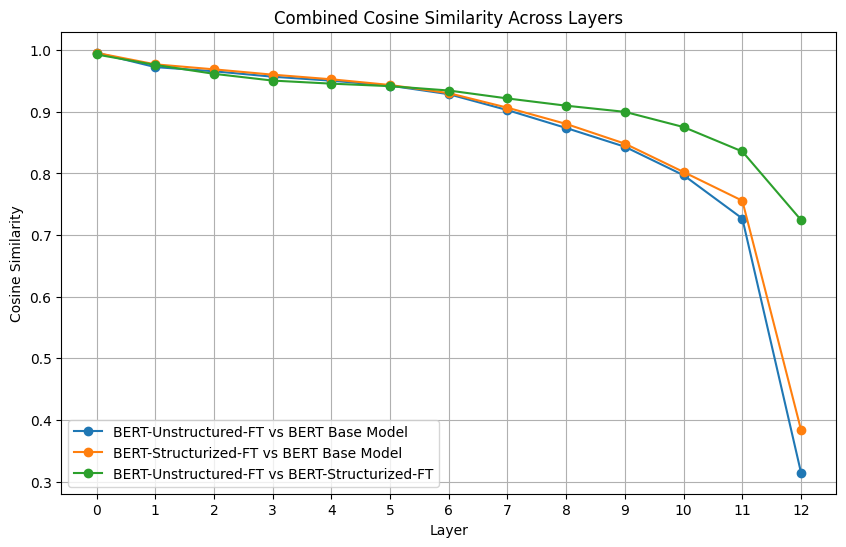

In [143]:
multimodel_model_comparator.multi_plot_cosine_similarity(question, context, representation_type = "hidden_states")

### Structurized Input

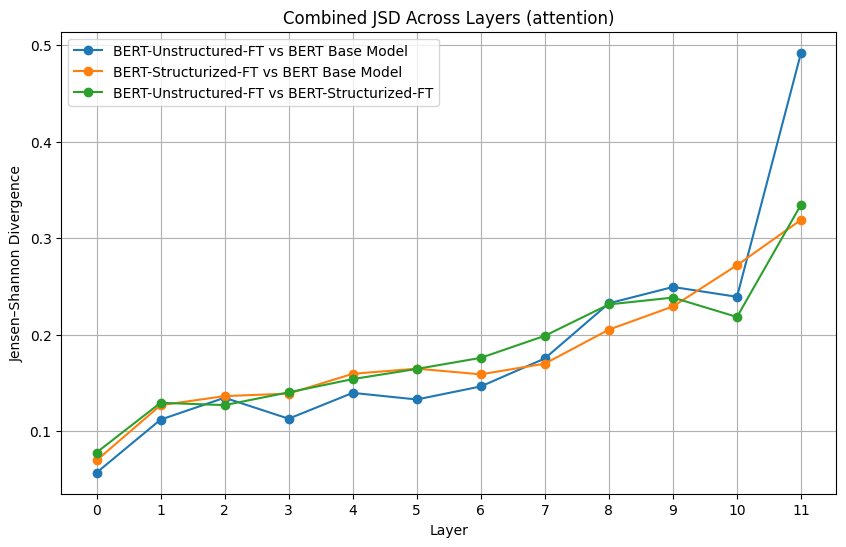

In [144]:
multimodel_model_comparator.multi_plot_jsd(question, structurized_context, representation_type = "attention")

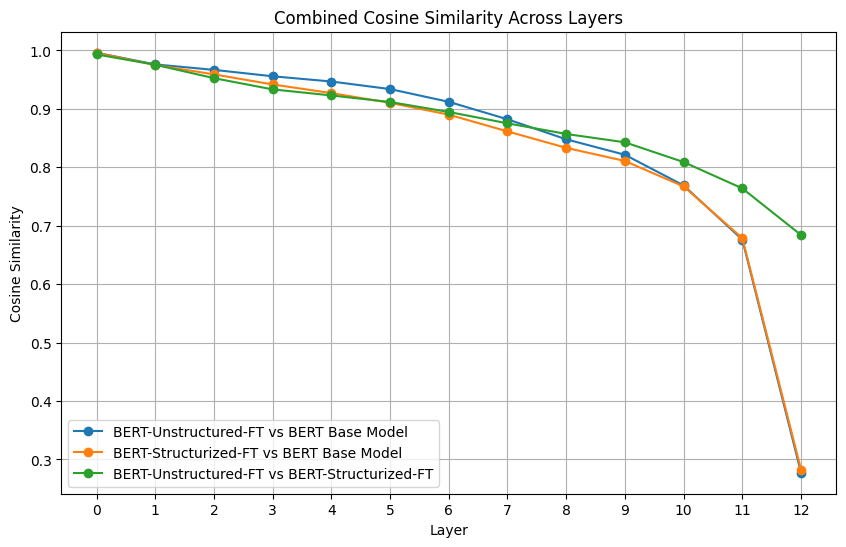

In [145]:
multimodel_model_comparator.multi_plot_cosine_similarity(question, structurized_context, representation_type = "hidden_states")

## Input Comparison

In [146]:
multimodel_input_comparator = MultiModelInputComparator(question, context, structurized_context)

### Pairwise

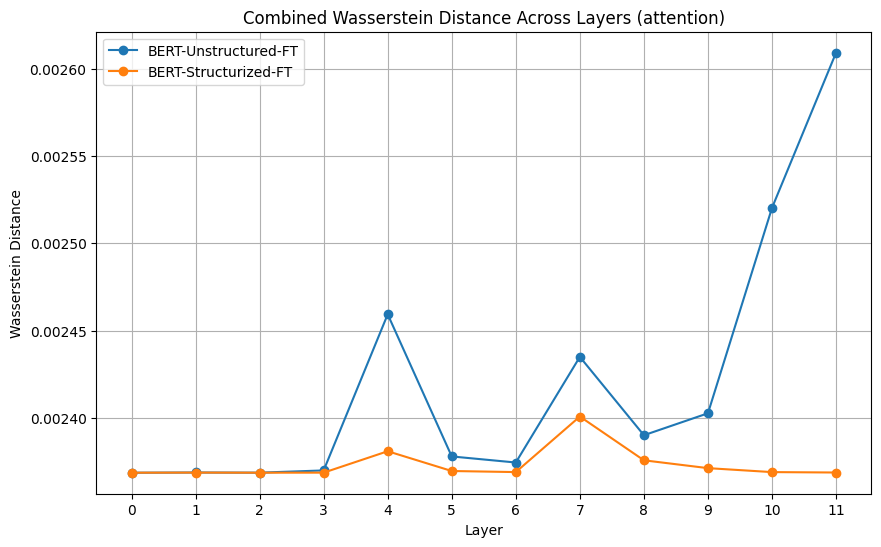

In [147]:
multimodel_input_comparator.multi_plot([qa_analyzer_unstructured, qa_analyzer_structurized], representation_type="attention")

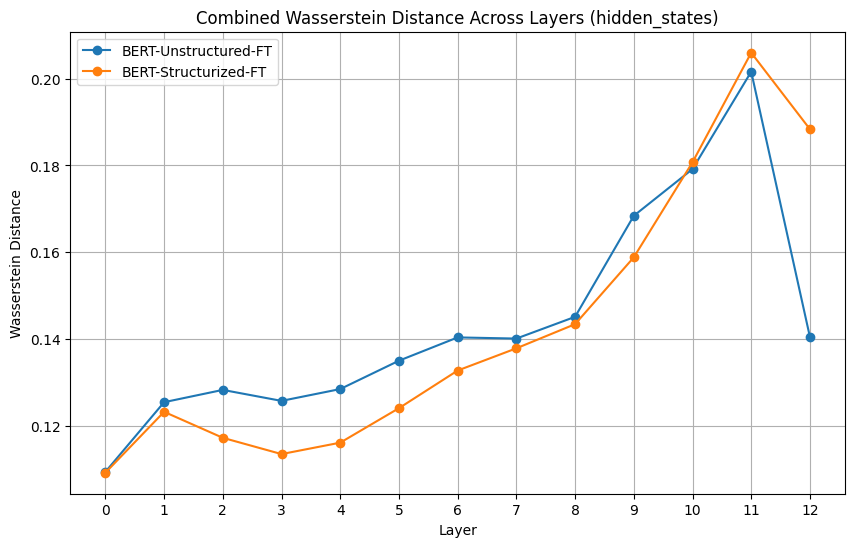

In [148]:
multimodel_input_comparator.multi_plot([qa_analyzer_unstructured, qa_analyzer_structurized], representation_type="hidden_states")

### All 3 Models

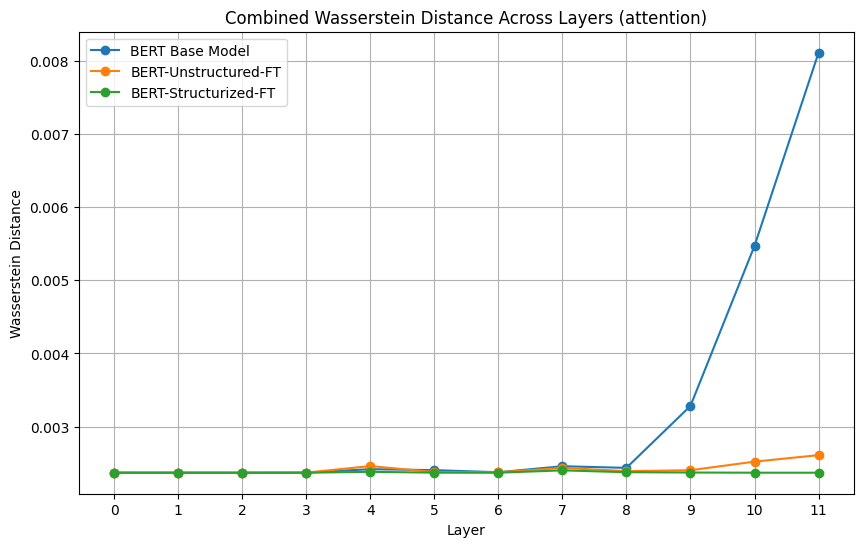

In [149]:
multimodel_input_comparator.multi_plot([qa_analyzer_base, qa_analyzer_unstructured, qa_analyzer_structurized], representation_type="attention")

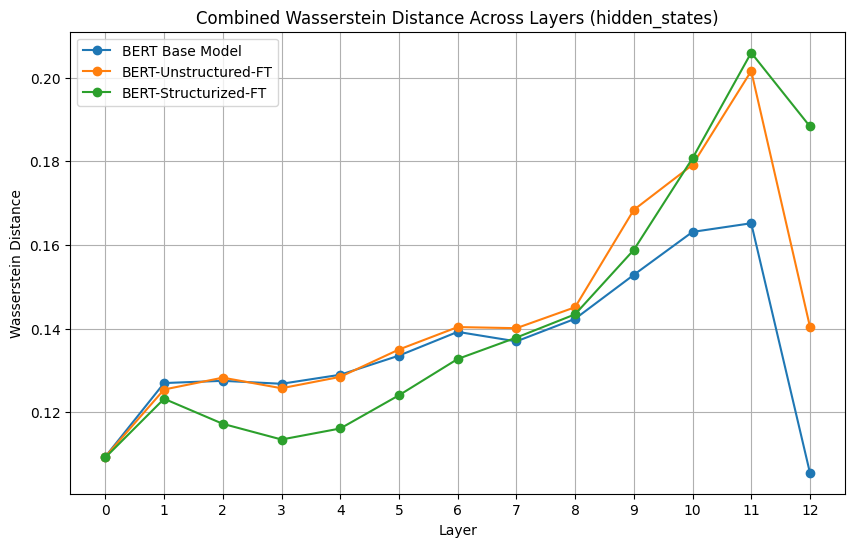

In [150]:
multimodel_input_comparator.multi_plot([qa_analyzer_base, qa_analyzer_unstructured, qa_analyzer_structurized])